In [1]:
import sys
sys.path.append("../../Postprocessing")

from UPPEPostprocessing import UPPE

In [4]:
files = {"A_w_R":"../UPPE/output/001_25_HHG_R.bin",
         "A_w_I":"../UPPE/output/001_25_HHG_I.bin",
         "w_active":"../UPPE/output/001_25_HHG_w.bin",
         "ionisation":"../UPPE/output/001_25_HHG_E.bin"}

parameters = {"radius":75.0e-6,
              "N_t":50000,
              "Z":0.07,
              "Z_min":0.0035,
              "N_z":100,
              "w_active_min_index":32}
run_000 = UPPE(files=files, parameters=parameters, labels="800", format=False)

In [2]:
from UPPEPostprocessing import UPPE

files = {"A_w_R":"../UPPE/output/000_1_A_w_R.bin",
         "A_w_I":"../UPPE/output/000_1_A_w_I.bin",
         "w_active":"../UPPE/output/000_1_w_active.bin",
         "ionisation":"../UPPE/output/000_1_electron_density.bin"}

parameters = {"radius":75.0e-6,
              "N_t":50000,
              "Z":0.07,
              "Z_min":0.0035,
              "N_z":100,
              "w_active_min_index":32}
run_000 = UPPE(files=files, parameters=parameters, labels="800", format=False)

In [3]:
run_000.A_w_m().shape

run_000.A_w_R_header()

{'Data_size': 24840,
 'Double_size': 8,
 'Format': b'UPPE',
 'Header_size': 32,
 'N_col': 20,
 'N_row': 1242,
 'Subversion': 0,
 'Version': 1}

In [25]:
files = {"A_w_R":"../../Results/UPPE/BlueLight/5fsFWHM/0.2mBarPressure/0.6WP/data/002_1_A_w_R.bin",
         "A_w_I":"../../Results/UPPE/BlueLight/5fsFWHM/0.2mBarPressure/0.6WP/data/002_1_A_w_I.bin",
         "w_active":"../../Results/UPPE/BlueLight/5fsFWHM/0.2mBarPressure/0.6WP/data/002_1_w_active.bin",
         "ionisation":"../../Results/UPPE/BlueLight/5fsFWHM/0.2mBarPressure/0.6WP/data/002_1_electron_density.bin"}

#files = {"A_w_R":"../UPPE/output/000_89_A_w_R.bin",
#         "A_w_I":"../UPPE/output/000_89_A_w_I.bin",
#         "w_active":"../UPPE/output/000_89_w_active.bin",
#         "ionisation":"../UPPE/output/000_89_electron_density.bin"}

parameters = {"radius":75.0e-6,
              "N_t":16384,
              "Z":0.07,
              "Z_min":0.0035,
              "N_z":100,
              "w_active_min_index":32}
run_000 = UPPE(files=files, parameters=parameters, labels="800")

In [3]:
print(run_000.radial_grid()[0])
print(run_000.radial_grid()[10])
print(run_000.radial_grid()[-1])

4.45910193034e-07
6.26281705262e-06
7.44174766218e-05


In [4]:
run_000.data.A_w_R_header()

{'Data_size': 158976,
 'Double_size': 8,
 'Format': b'UPPE',
 'Header_size': 32,
 'N_col': 128,
 'N_row': 1242,
 'Subversion': 0,
 'Version': 1}

## Plot Data (Spectral Amplitude against Angular Frequency)

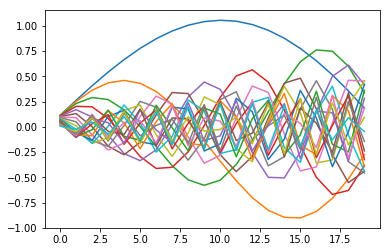

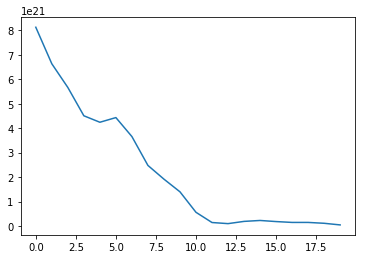

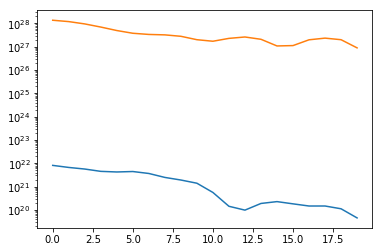

In [43]:
from scipy.special import jn
import numpy as np
import struct
from matplotlib import pyplot as plt
#from matplotlib.mlab import griddata
from scipy.interpolate import griddata

fileName = "input/J0_zeros.bin"
f = open(fileName, mode='rb')

N_modes = np.shape(run_000.data.A_w_R())[0]
N_rows = N_modes
max_norm = int(np.sqrt(N_modes**2 + N_modes**2))
N_col = 1
double_size = 8

data = np.zeros(int(max_norm))
content = f.read(8*int(max_norm))
f.close()
data_stream = struct.unpack("d"*int(max_norm), content)
J0 = np.array(data_stream)
            
            

H = np.zeros([N_modes, N_modes])
for i in range(N_modes):
    for j in range(N_modes):
        H[i, j] = (2.0 / J0[N_modes]) * jn(0, (J0[j]*J0[i] / J0[N_modes])) / jn(1, (J0[j]))**2
H = np.array(H, dtype=complex)

plt.figure()
for i in range(N_modes):
    plt.plot(H[i].real)
plt.show()

Z = np.zeros([1242, N_modes], dtype=np.complex128)
A = run_000.data.A_w_R() + 1j * run_000.data.A_w_I()
for i in range(1242):
    Z[i] = H.dot(A[:, i])

n = 5
plt.figure()
plt.plot(Z[n].real**2 + Z[n].imag**2)
plt.show()

plt.figure()
plt.semilogy(Z[n].real**2 + Z[n].imag**2)
plt.semilogy(np.sum(Z.real**2 + Z.imag**2, axis=0))
plt.show()

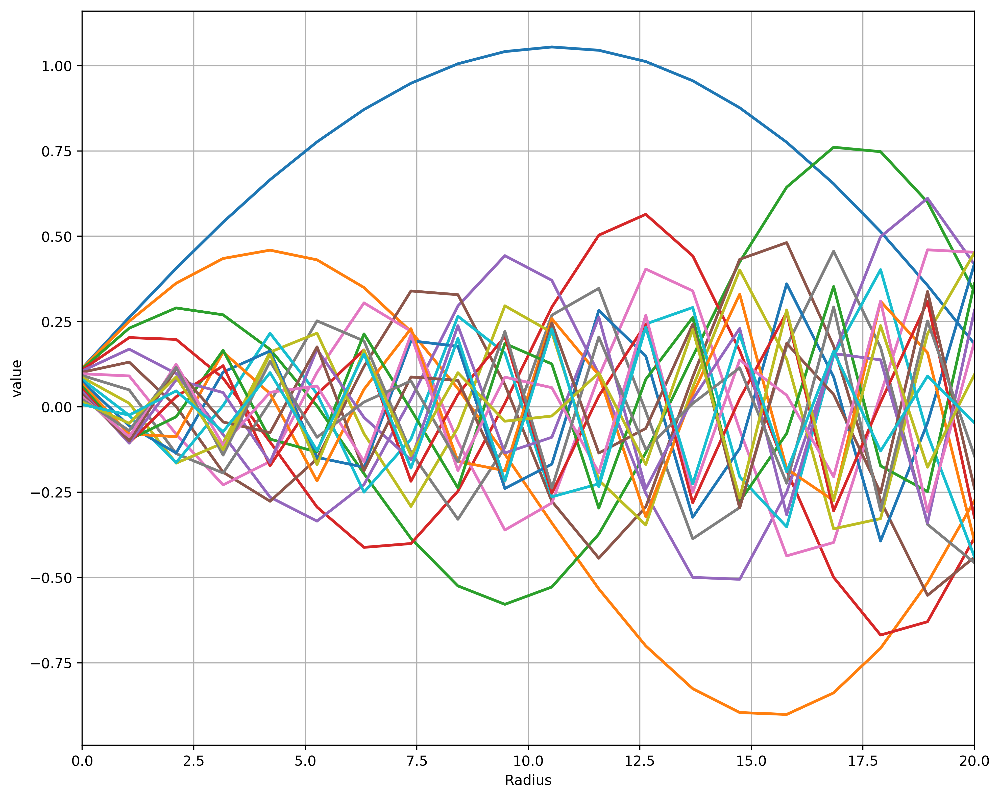

In [69]:
run_000.plot.hankel_transform()

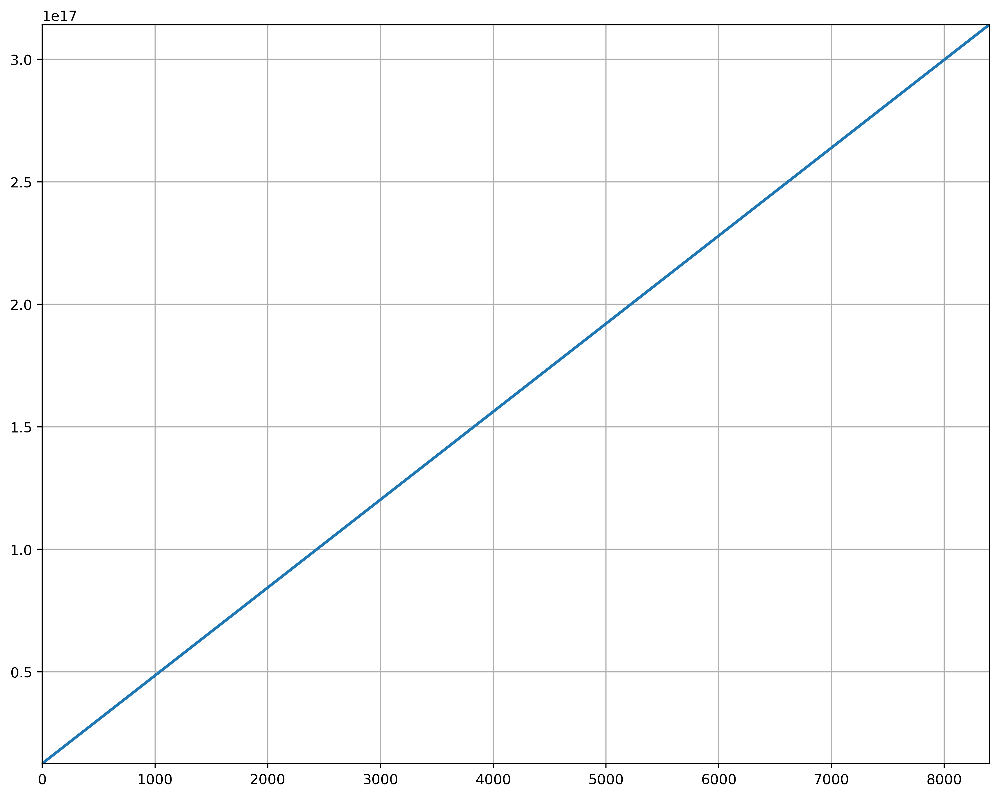

In [65]:
run_000.plot.w_active()

In [8]:
xi = np.linspace(-max_norm, max_norm, 2*max_norm+1)
yi = np.linspace(-max_norm, max_norm, 2*max_norm+1)
xi = np.linspace(-max_norm, max_norm, 2*max_norm+1)
yi = np.linspace(-max_norm, max_norm, 2*max_norm+1)
#xi[0:28] = -J0
#xi[29:] = J0
#yi[0:28] = J0
#yi[29:] = J0

J = np.zeros([2*max_norm+1])
J[0:max_norm] = -J0
J[max_norm+1:] = J0

X, Y = np.meshgrid(J, J)


tmp = np.sum(Z, axis=0)
tmp = Z[100]
tmp = Z[350]
tmp = Z[5]
#tmp = Z[-1]
Z = np.zeros([int(max_norm)])
Z[0:N_modes] = tmp
Grid = np.zeros([2*int(max_norm)+1, 2*int(max_norm)+1], dtype=np.complex128)
for i in range(N_modes):
    for j in range(N_modes):
        norm = np.sqrt(i**2 + j**2)
        #print(norm, i , j)
        Grid[int(max_norm) + 1 + i, int(max_norm) + 1 + j] = Z[int(norm)]
        Grid[max_norm-1 - i, max_norm-1 - j] = Z[int(norm)]
        Grid[max_norm-1 - i, int(max_norm) + 1 + j] = Z[int(norm)]
        Grid[int(max_norm) + 1 + i, max_norm-1 - j] = Z[int(norm)]
Grid[max_norm, :] = Grid[max_norm+1, :]
Grid[:, max_norm] = Grid[:, max_norm+1]
        
        
intensity = np.array(np.abs(Grid.real**2 + Grid.imag**2), dtype=np.float64)

ncols, nrows = 2*max_norm+1, 2*max_norm+1
xi = np.linspace(-max_norm, max_norm, ncols)
yi = np.linspace(-max_norm, max_norm, nrows)
#xi, yi = np.meshgrid(xi, yi)
print(np.shape(xi), np.shape(yi), np.shape(J), np.shape(intensity))
#from matplotlib.mlab import griddata
#zi = griddata(J, J, intensity, xi, yi)


#from scipy import interpolate
#f = interpolate.interp2d(xi, yi, intensity, kind='linear')
#xinew = np.arange(-max_norm, max_norm, 0.25)
#yinew = np.arange(-max_norm, max_norm, 0.25)

#fig = plt.figure(figsize=(16,8))
#ax1 = fig.add_subplot(1, 4, 1)
#ax2 = fig.add_subplot(1, 4, 2)
#ax3 = fig.add_subplot(1, 4, 3)
#ax4 = fig.add_subplot(1, 4, 4)
#ax1.pcolor(xi[:28], yi[:28], intensity[:28, :28], cmap="hot")
#ax2.pcolor(xi[:28], yi[28+1:], intensity[:28, 28+1:], cmap="hot")
#ax3.pcolor(xi[28+1:], yi[:28], intensity[28+1:, :28], cmap="hot")
#ax4.pcolor(xi[28+1:], yi[28+1:], intensity[28+1:, 28+1:], cmap="hot")
#plt.show()

fig = plt.figure(figsize=(8,8))
ax1 = fig.add_subplot(1, 1, 1)
ax1.pcolor(xi, yi, intensity, cmap="jet")
plt.show()

#fig = plt.figure(figsize=(8,8))
#ax1 = fig.add_subplot(1, 1, 1)
#ax1.pcolor(xinew, yinew, f(xinew, yinew), cmap="jet")
#plt.show()

#fig = plt.figure(figsize=(8,8))
#ax1 = fig.add_subplot(1, 1, 1)
#ax1.contourf(xi, yi, intensity, cmap="jet")
#plt.show()


#fig = plt.figure(figsize=(8,8))
#ax1 = fig.add_subplot(1, 1, 1, projection='polar')
##ax1.pcolor(Z[n].real**2 + Z[n].imag**2, J0, cmap="jet")
#ax1.pcolor(J, J, intensity, cmap="jet")
#plt.show()

NameError: name 'np' is not defined

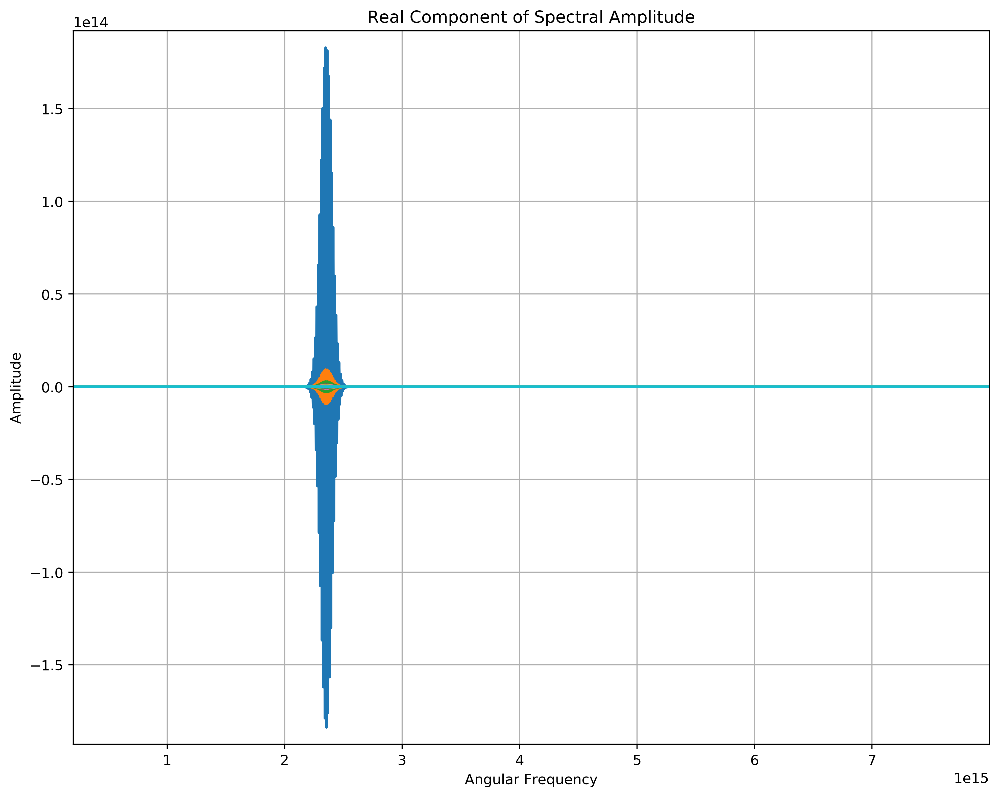

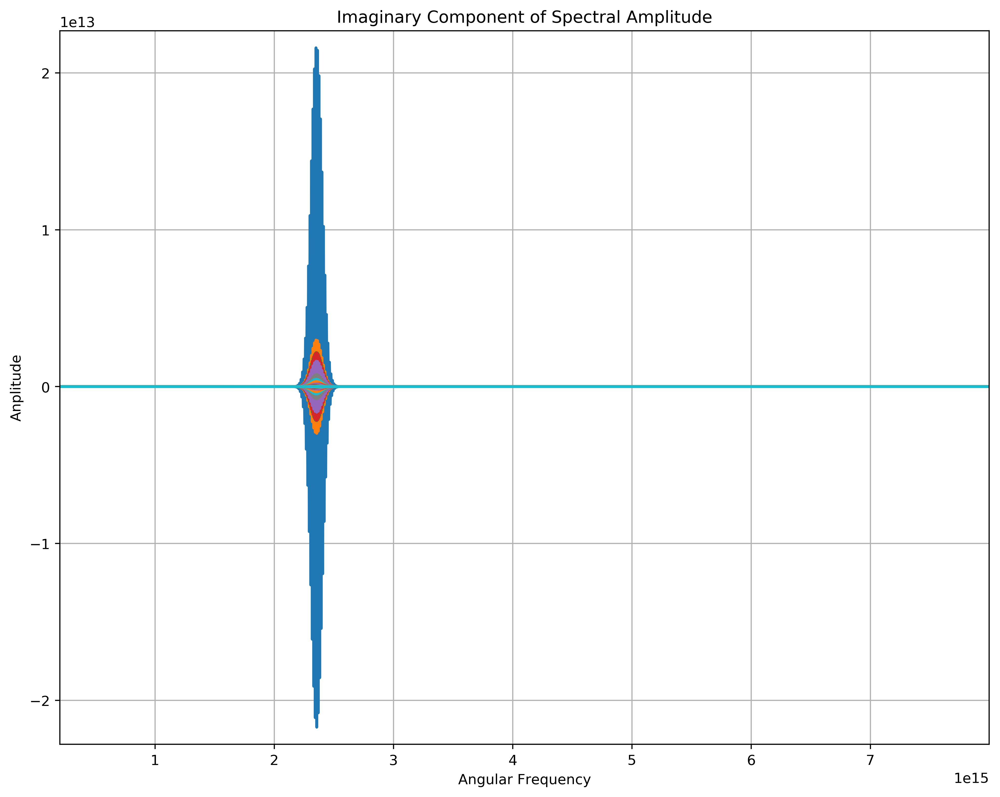

In [4]:
run_000.plot.amplitude_frequency_real()#ylim=(-1e-12, 1e-12))
run_000.plot.amplitude_frequency_imag()

## Plot Modulus of Amplitude against Angular Frequency

/home/sam/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/sam/anaconda3/lib/python3.6/site-packages/matplotlib/transforms.py:994: ComplexWarning: Casting complex values to real discards the imaginary part
  self._points[:, 1] = interval


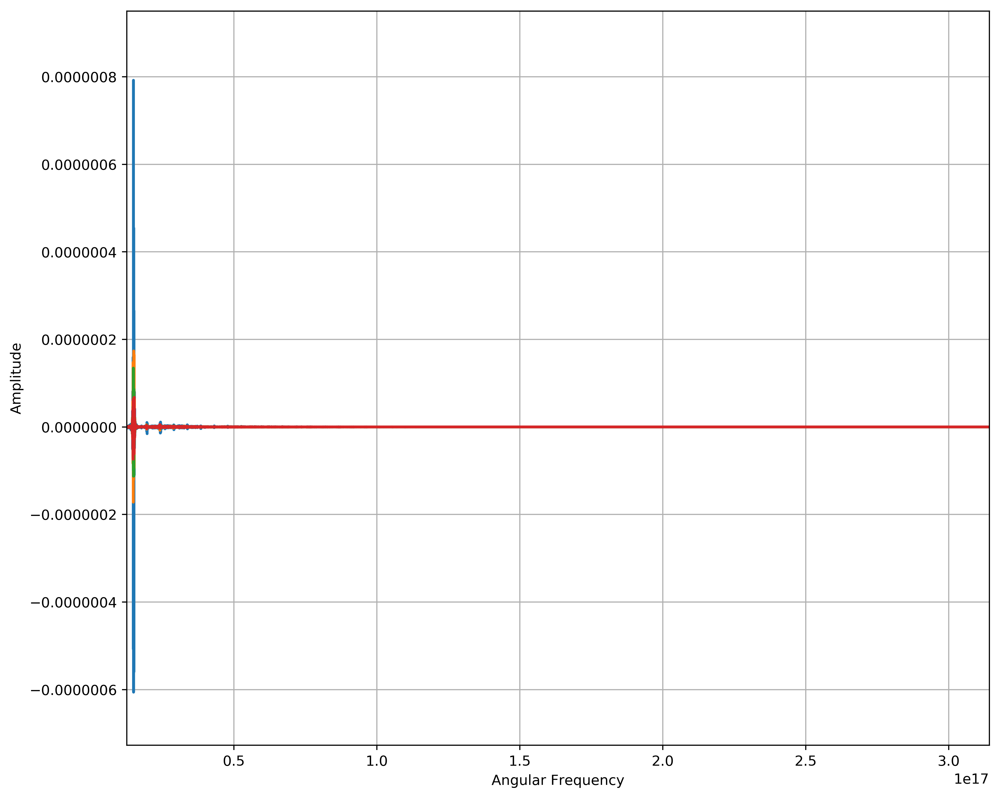

In [61]:
run_000.plot.amplitude_modulus_frequency(representation="mode")

/home/sam/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/sam/anaconda3/lib/python3.6/site-packages/matplotlib/transforms.py:994: ComplexWarning: Casting complex values to real discards the imaginary part
  self._points[:, 1] = interval


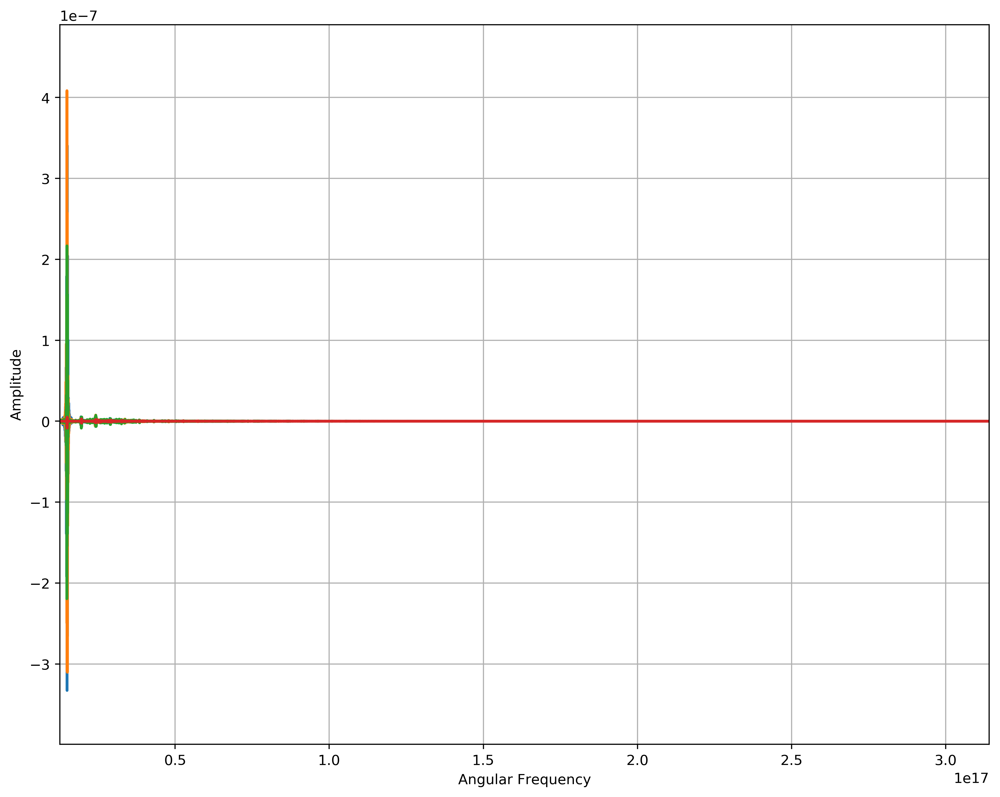

In [62]:
run_000.plot.amplitude_modulus_frequency(representation="radial")

## Plot Intensity against Angular Frequency

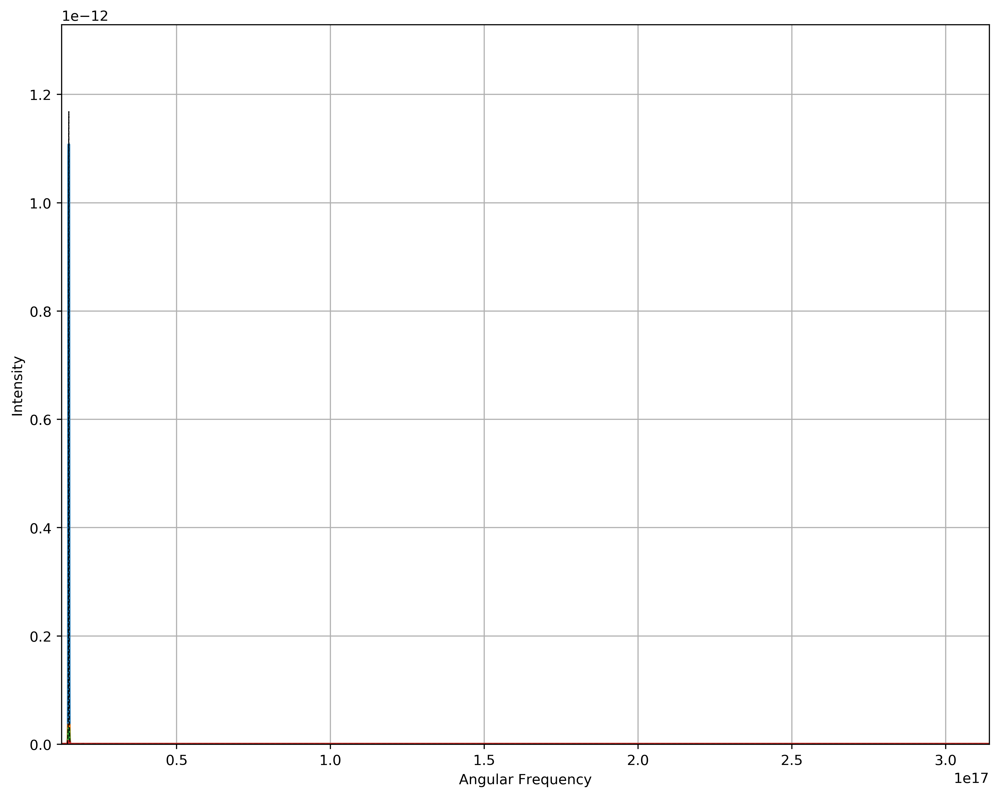

In [59]:
run_000.plot.intensity_frequency(representation="mode")

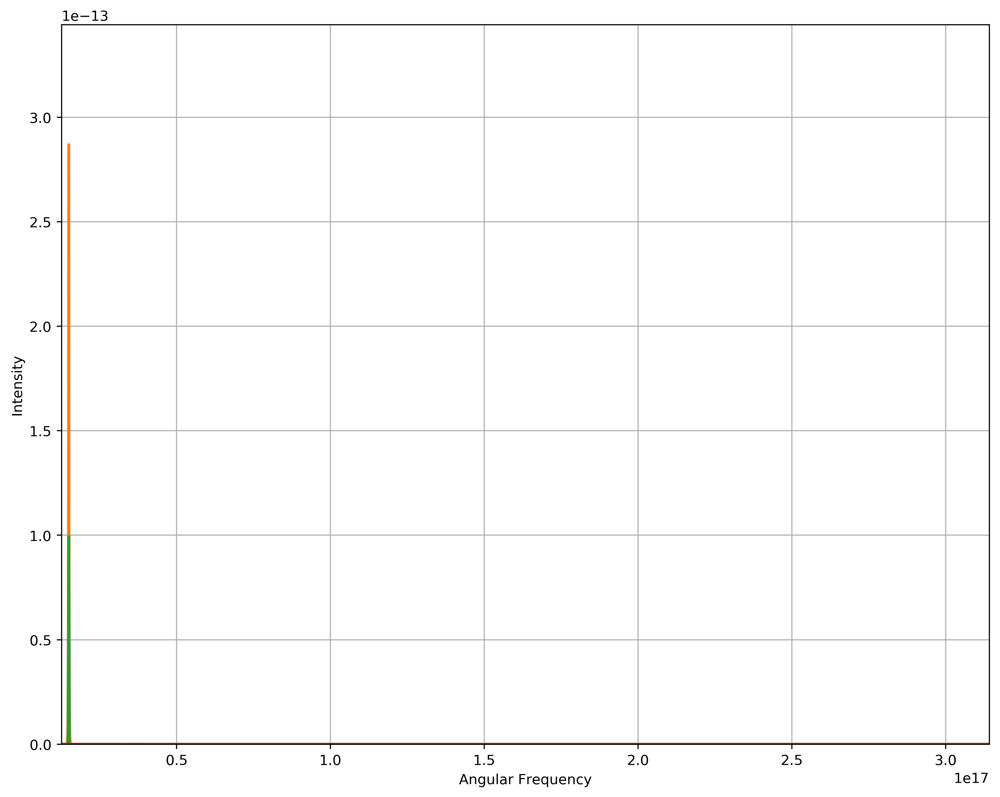

In [60]:
run_000.plot.intensity_frequency(representation="radial")

## Plot Intensity against Wavelength

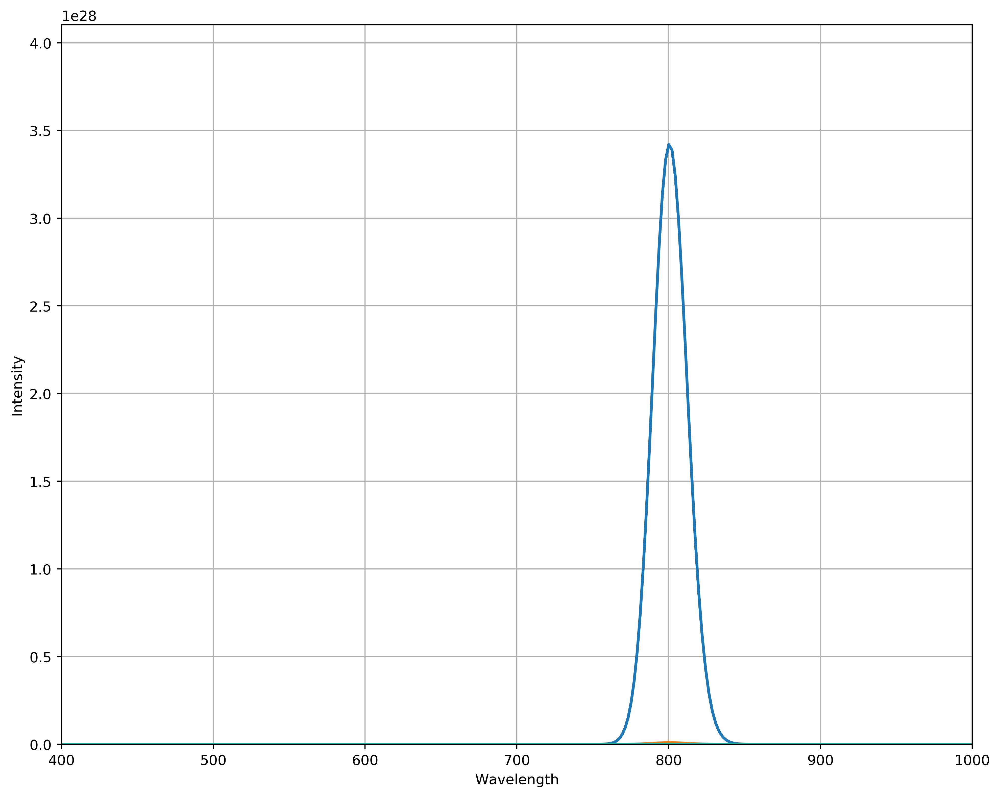

In [8]:
run_000.plot.intensity_wavelength(xlim=(400, 1000),#xlim=(10, 150), ylim=(0, 0.5e-15),
                                  representation="mode")

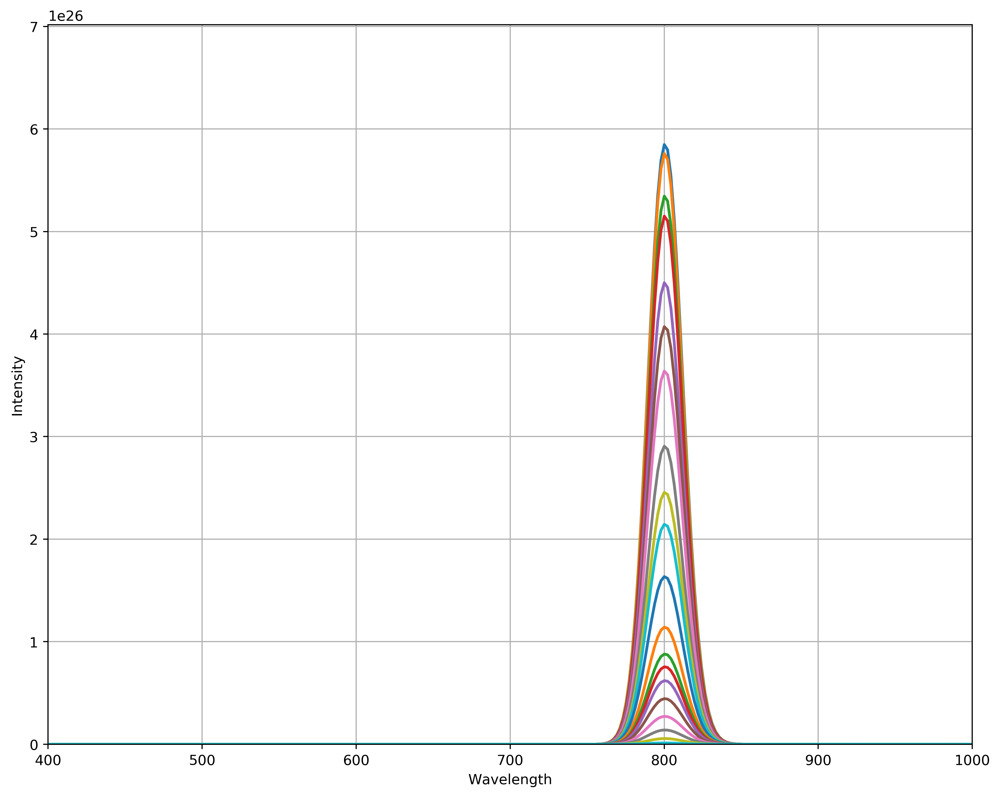

In [9]:
run_000.plot.intensity_wavelength(xlim=(400, 1000),#xlim=(10, 150), ylim=(0, 0.5e-15),
                                  representation="radial")

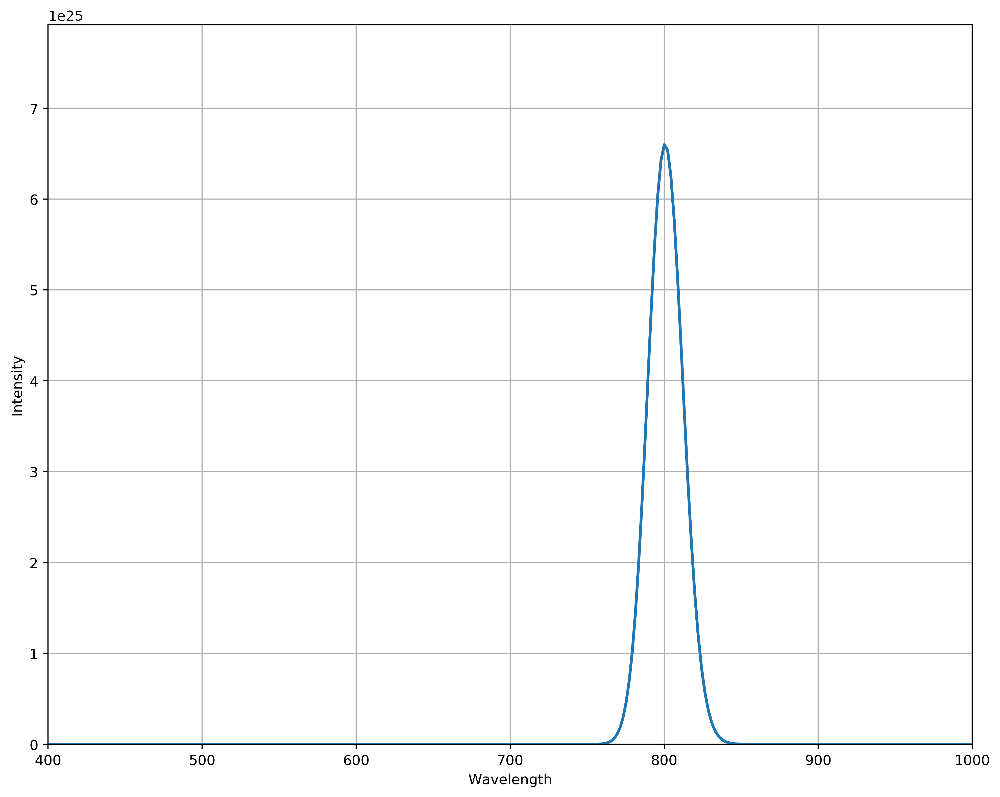

In [10]:
run_000.plot.intensity_wavelength(xlim=(400, 1000),#xlim=(10, 150), ylim=(0, 0.5e-15),
                                  representation="radial",
                                  radially_weighted=True)

In [11]:
run_000.plot.intensity_wavelength(#xlim=(6, 150), ylim=(0, 0.5e-10),
                                  representation="radial",
                                  semilogy=True,
                                  radially_weighted=True)

TypeError: intensity_wavelength() got an unexpected keyword argument 'semilogy'

# Amplitude against Time

/home/sam/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/sam/anaconda3/lib/python3.6/site-packages/matplotlib/transforms.py:994: ComplexWarning: Casting complex values to real discards the imaginary part
  self._points[:, 1] = interval


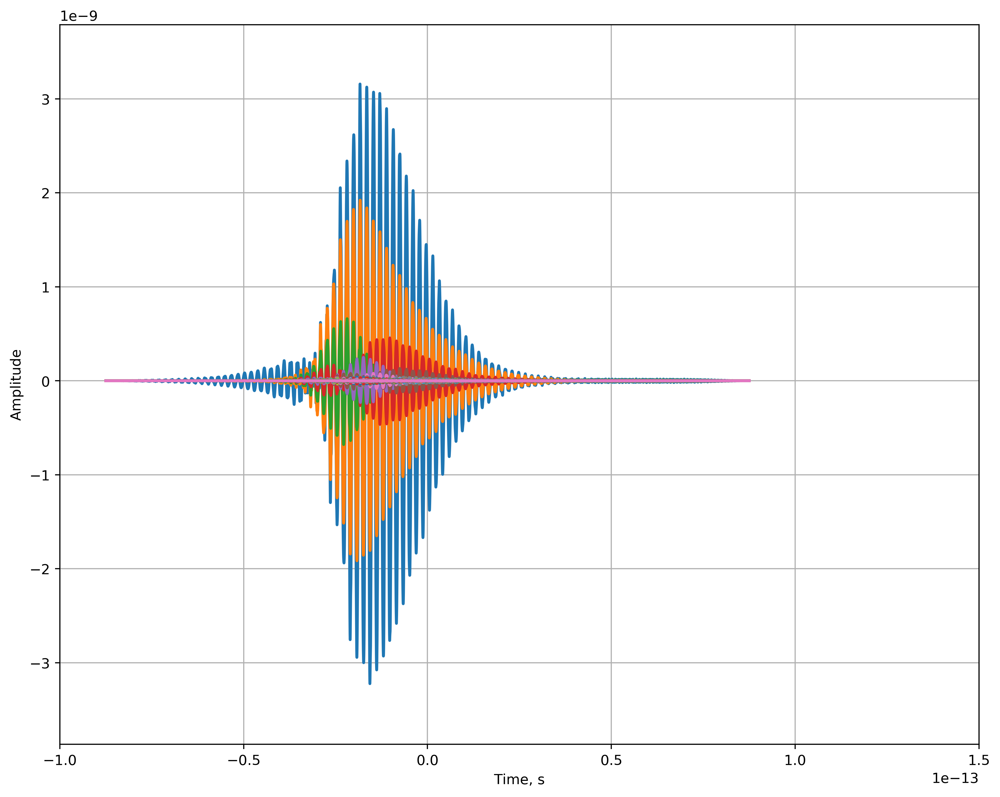

In [16]:
run_000.plot.amplitude_time(xlim=(-100.0e-15, 150.0e-15),
                            representation="mode")

/home/sam/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/sam/anaconda3/lib/python3.6/site-packages/matplotlib/transforms.py:994: ComplexWarning: Casting complex values to real discards the imaginary part
  self._points[:, 1] = interval


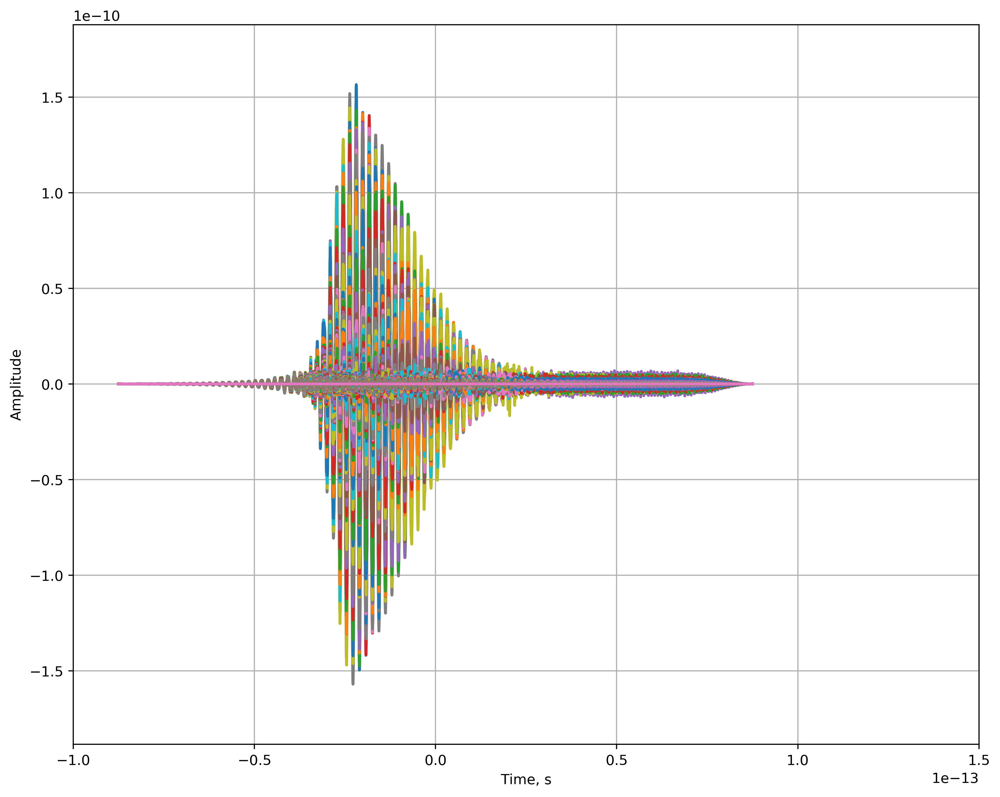

In [17]:
run_000.plot.amplitude_time(xlim=(-100.0e-15, 150.0e-15),
                            representation="radial")

/home/sam/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/home/sam/anaconda3/lib/python3.6/site-packages/matplotlib/transforms.py:994: ComplexWarning: Casting complex values to real discards the imaginary part
  self._points[:, 1] = interval


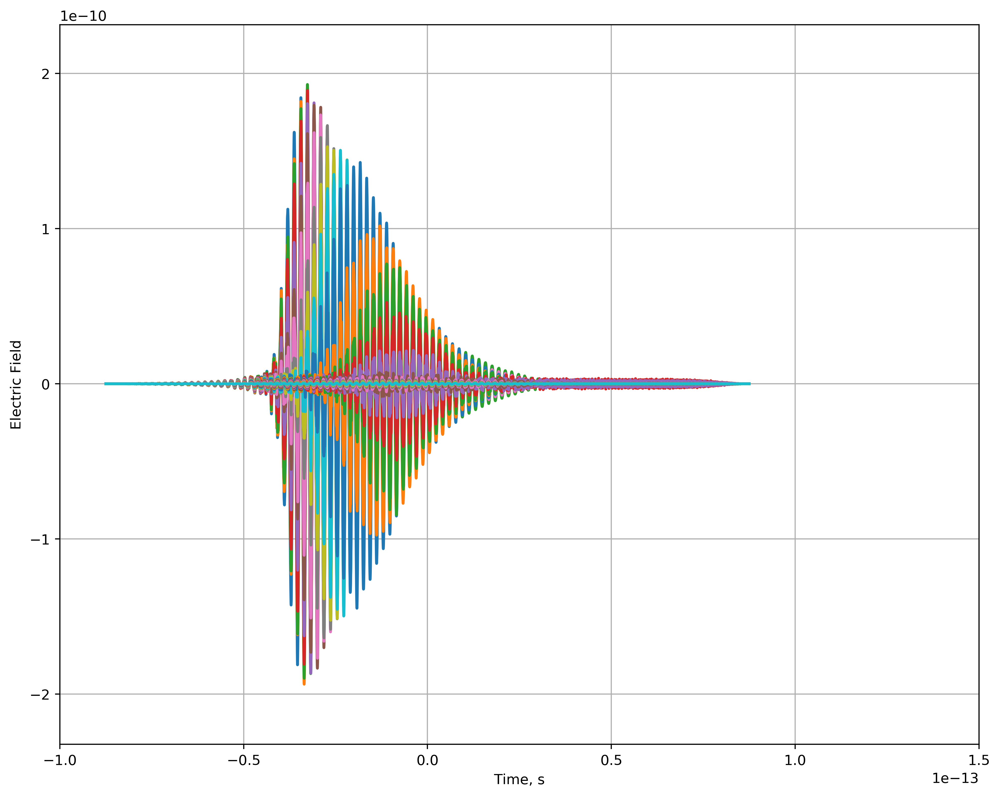

In [76]:
run_000.plot.electricField_time(xlim=(-100e-15, 150e-15), 
                                representation="radial")

# Intensity against Time

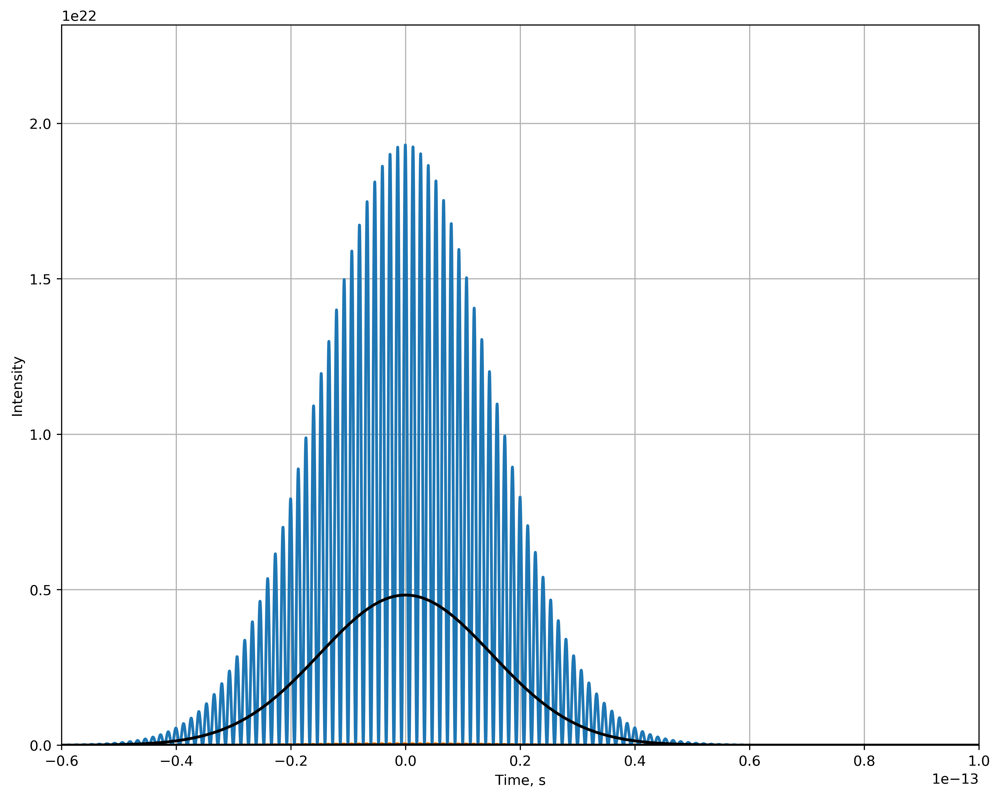

In [11]:
run_000.plot.intensity_time(xlim=(-60.0e-15, 100.0e-15),
                            representation="mode",
                            field="both")

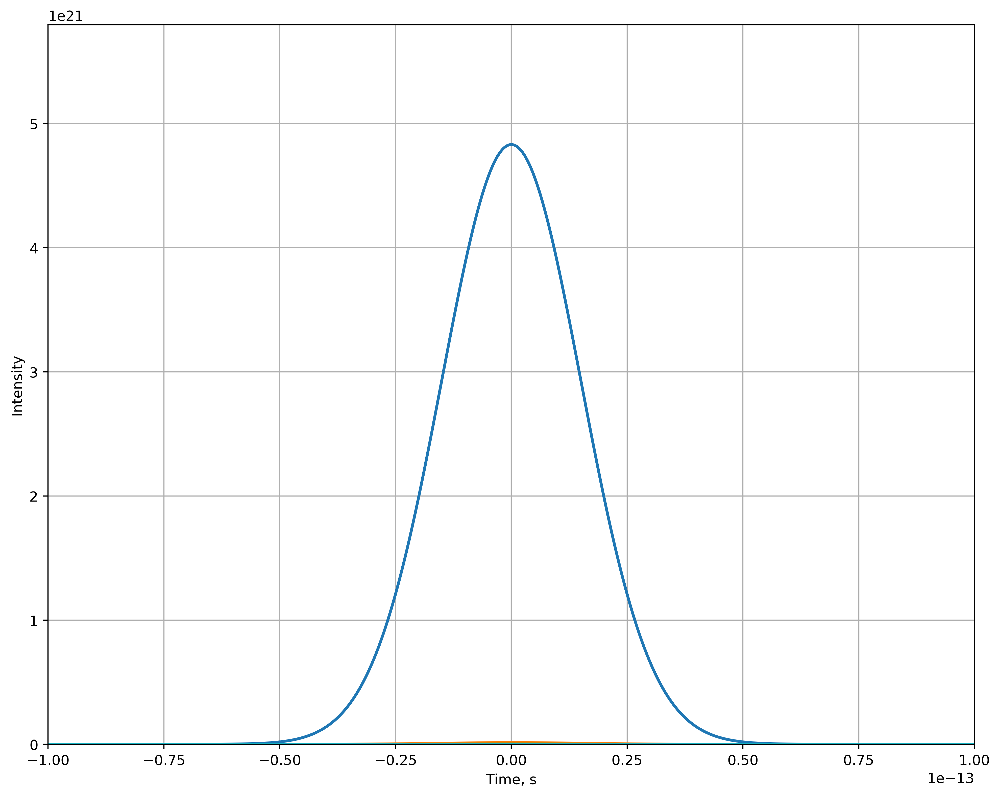

In [15]:
run_000.plot.intensity_time(xlim=(-100.0e-15, 100.0e-15),
                            representation="mode",
                            field="envelope")

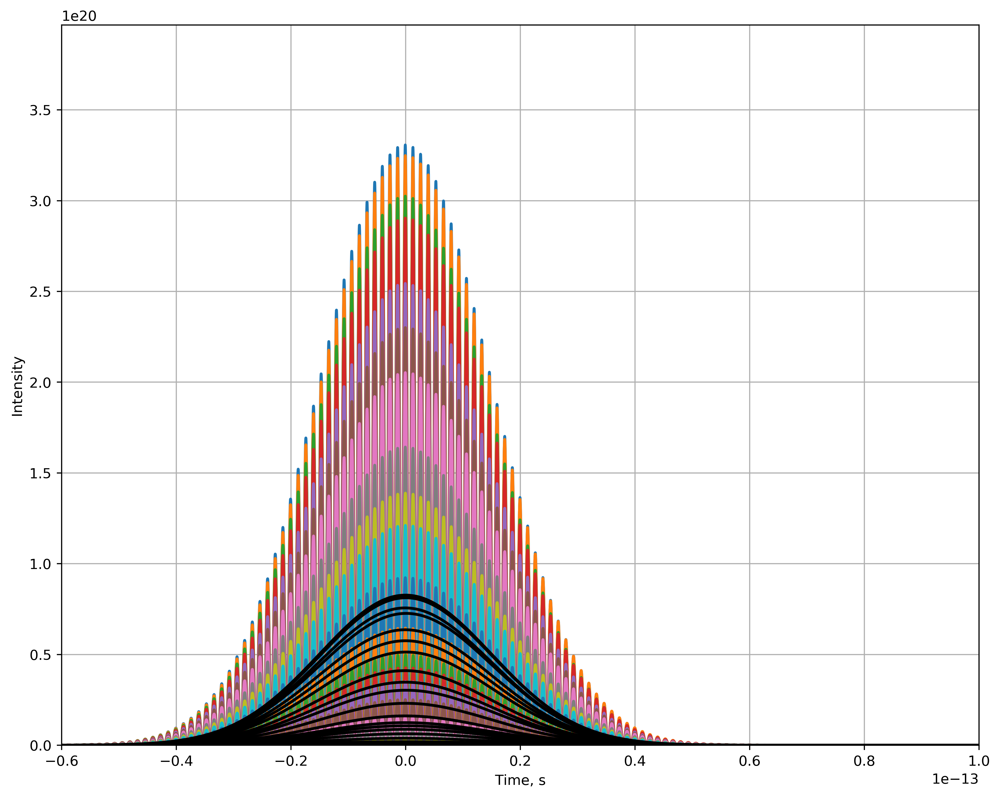

In [13]:
run_000.plot.intensity_time(xlim=(-60.0e-15, 100.0e-15),
                            representation="radial",
                            field="both")

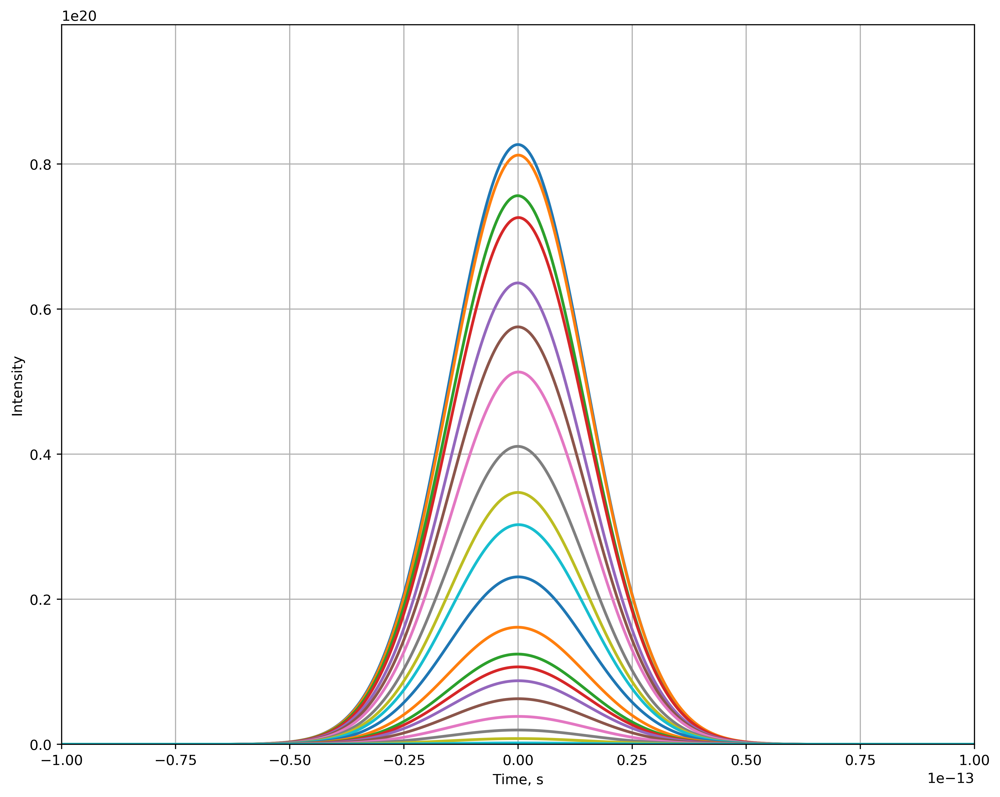

In [17]:
run_000.plot.intensity_time(xlim=(-100.0e-15, 100.0e-15),
                            representation="radial",
                            field="envelope")

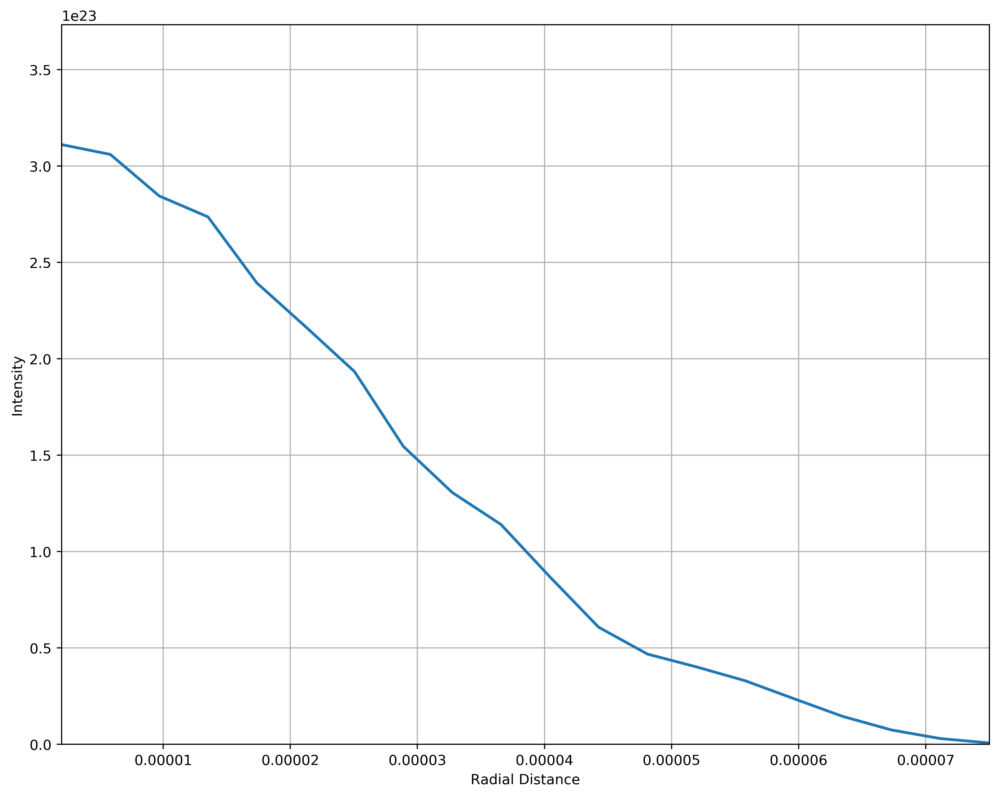

In [18]:
run_000.plot.intensity_radialDistance()

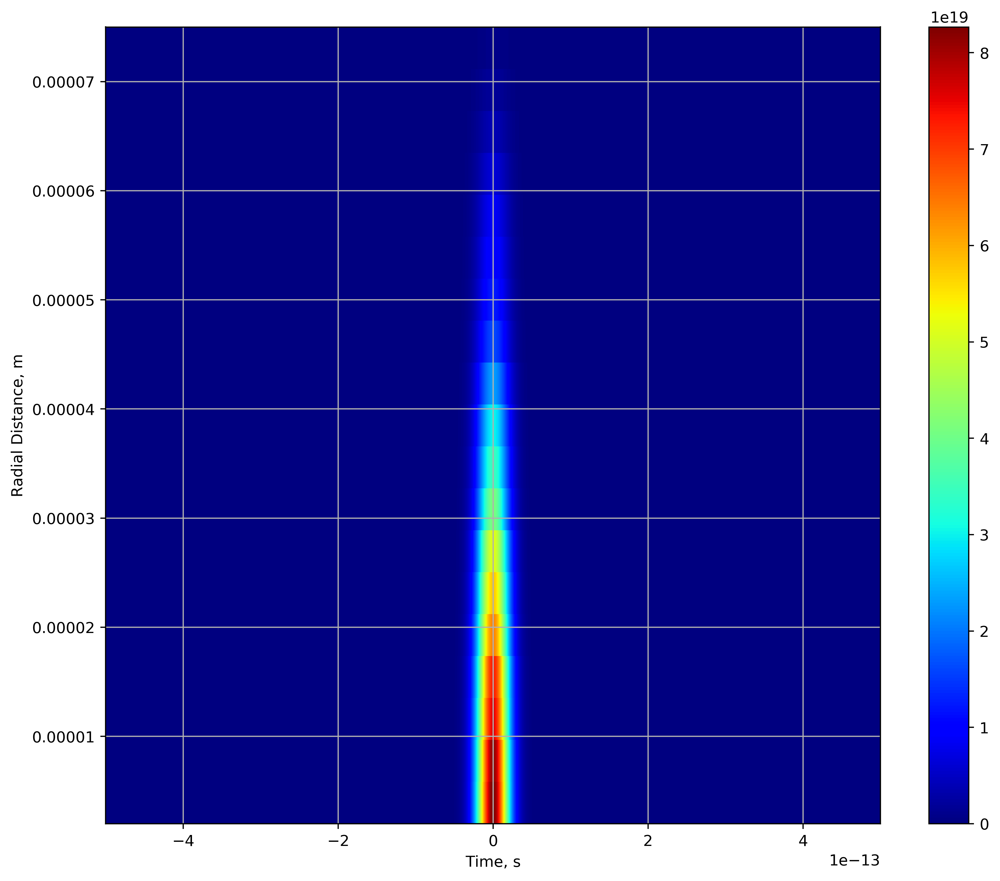

In [19]:
run_000.plot.time_radialDistance(x_step_size=10)#, xlim=(-100e-15, 100e-15))

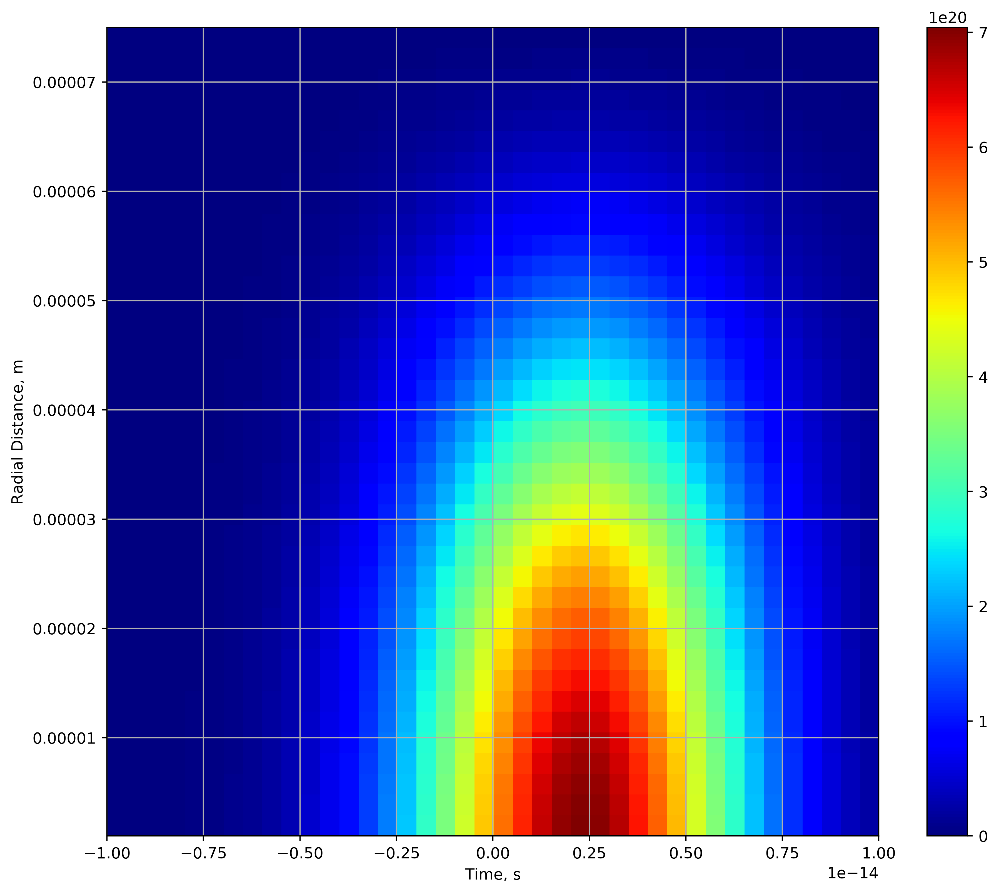

In [21]:
run_000.plot.time_radialDistance(x_step_size=10, xlim=(-10e-15, 10e-15))

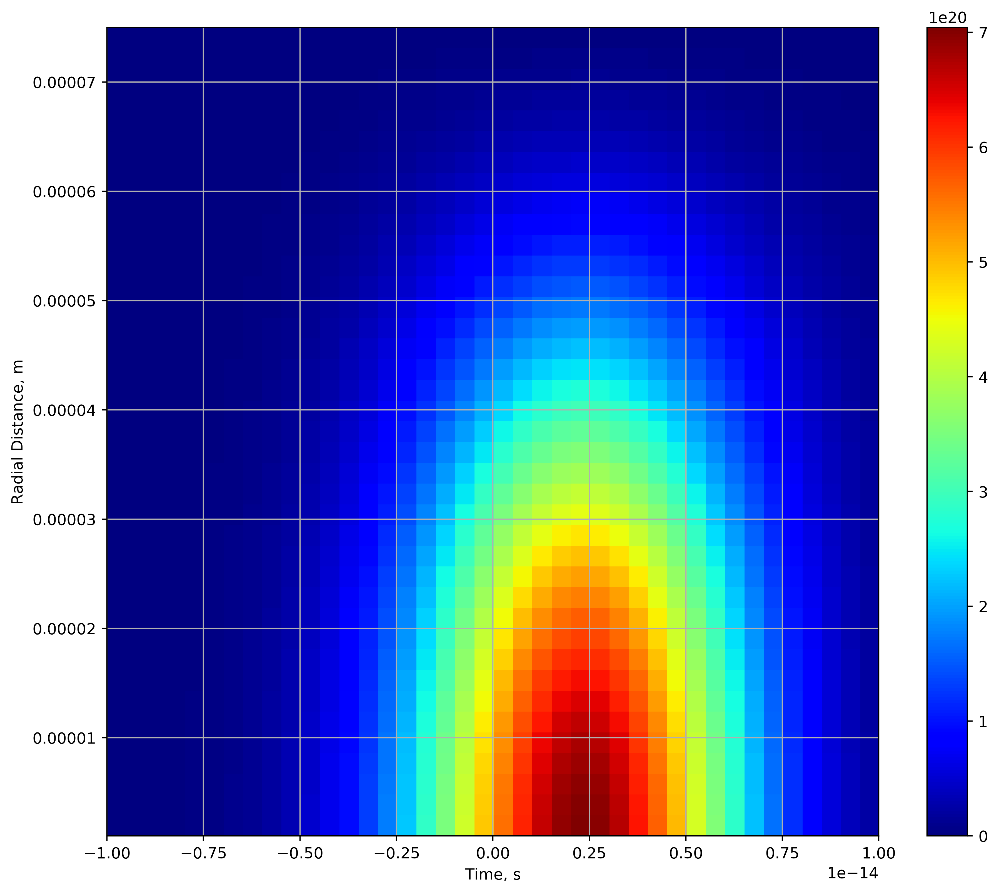

In [22]:
run_000.plot.time_radialDistance(x_step_size=10, xlim=(-10e-15, 10e-15))

In [254]:
phi_w = np.angle(A_w)
phi_t = np.angle(A_t)

plt.figure(figsize=(10,8))
plt.plot(t, phi_t)
#plt.plot(np.unwrap(phi_w[940:], discont=2*np.pi))
#lt.plot(np.unwrap(phi_t[12830:13410], discont=120*np.pi))
plt.xlim(-0.25E-13, 0.25E-13)
plt.grid()
plt.show()

phi_t_unwrap = np.copy(phi_t)

for i in range(1, len(phi_t)):
    if np.abs(phi_t[i-1] - phi_t[i]) >= np.pi*1.9:
        phi_t_unwrap[i] = phi_t[i] + 1.9*np.pi

phi_test = np.unwrap(phi_t[12830:13410], discont=1*np.pi)

plt.figure(figsize=(10,8))
plt.plot(t, phi_t_unwrap/np.max(phi_t_unwrap))
plt.plot(t[12830:13410], phi_test/np.max(phi_test))
plt.plot(t, np.abs(A_t)**2/np.max(np.abs(A_t)**2))
#plt.plot(t, np.unwrap(phi_t, discont=1.0*np.pi))
plt.xlim(-0.25E-13, 0.25E-13)
plt.grid()
plt.show()

phi_w_test = np.unwrap(phi_w[100:600], discont=1*np.pi)

plt.figure(figsize=(10,8))
#plt.plot(phi_t_unwrap/np.max(phi_t_unwrap))
plt.plot(phi_w_test[100:600]/np.max(phi_w_test[100:600]))
#plt.plot(phi_w[100:600]/np.max(phi_w[100:600]))
plt.plot(np.abs(A_w[100:600])**2/np.max(np.abs(A_w[100:600])**2))
#plt.plot(t, np.unwrap(phi_t, discont=1.0*np.pi))
#plt.xlim(-0.25E-13, 0.25E-13)
plt.grid()
plt.show()

ValueError: x and y must have same first dimension, but have shapes (65536,) and (20, 1242)

## Plotting combined runs on the same plot

In [2]:
from UPPEPostprocessing import UPPE

In [2]:
import numpy as np

prop_step = "2"
path = "./output/increasingPower/"

files = np.array(((path+"000_"+prop_step+"_A_w_R.bin", path+"000_"+prop_step+"_A_w_I.bin", path+"000_"+prop_step+"_w_active.bin"),
                  (path+"001_"+prop_step+"_A_w_R.bin", path+"001_"+prop_step+"_A_w_I.bin", path+"001_"+prop_step+"_w_active.bin"),
                  (path+"002_"+prop_step+"_A_w_R.bin", path+"002_"+prop_step+"_A_w_I.bin", path+"002_"+prop_step+"_w_active.bin"),
                  (path+"003_"+prop_step+"_A_w_R.bin", path+"003_"+prop_step+"_A_w_I.bin", path+"003_"+prop_step+"_w_active.bin"),
                  (path+"004_"+prop_step+"_A_w_R.bin", path+"004_"+prop_step+"_A_w_I.bin", path+"004_"+prop_step+"_w_active.bin"),
                  (path+"005_"+prop_step+"_A_w_R.bin", path+"005_"+prop_step+"_A_w_I.bin", path+"005_"+prop_step+"_w_active.bin"),
                  (path+"006_"+prop_step+"_A_w_R.bin", path+"006_"+prop_step+"_A_w_I.bin", path+"006_"+prop_step+"_w_active.bin"),
                  (path+"007_"+prop_step+"_A_w_R.bin", path+"007_"+prop_step+"_A_w_I.bin", path+"007_"+prop_step+"_w_active.bin"),
                  (path+"008_"+prop_step+"_A_w_R.bin", path+"008_"+prop_step+"_A_w_I.bin", path+"008_"+prop_step+"_w_active.bin"),
                  (path+"009_"+prop_step+"_A_w_R.bin", path+"009_"+prop_step+"_A_w_I.bin", path+"009_"+prop_step+"_w_active.bin"),
                  (path+"010_"+prop_step+"_A_w_R.bin", path+"010_"+prop_step+"_A_w_I.bin", path+"010_"+prop_step+"_w_active.bin"),
                  (path+"011_"+prop_step+"_A_w_R.bin", path+"011_"+prop_step+"_A_w_I.bin", path+"011_"+prop_step+"_w_active.bin"),
                  (path+"012_"+prop_step+"_A_w_R.bin", path+"012_"+prop_step+"_A_w_I.bin", path+"012_"+prop_step+"_w_active.bin"),
                  (path+"013_"+prop_step+"_A_w_R.bin", path+"013_"+prop_step+"_A_w_I.bin", path+"013_"+prop_step+"_w_active.bin"), 
                  (path+"014_"+prop_step+"_A_w_R.bin", path+"014_"+prop_step+"_A_w_I.bin", path+"014_"+prop_step+"_w_active.bin"),
                  (path+"015_"+prop_step+"_A_w_R.bin", path+"015_"+prop_step+"_A_w_I.bin", path+"015_"+prop_step+"_w_active.bin"),
                  (path+"016_"+prop_step+"_A_w_R.bin", path+"016_"+prop_step+"_A_w_I.bin", path+"016_"+prop_step+"_w_active.bin"),
                  (path+"017_"+prop_step+"_A_w_R.bin", path+"017_"+prop_step+"_A_w_I.bin", path+"017_"+prop_step+"_w_active.bin"),
                  (path+"018_"+prop_step+"_A_w_R.bin", path+"018_"+prop_step+"_A_w_I.bin", path+"018_"+prop_step+"_w_active.bin"),
                  (path+"019_"+prop_step+"_A_w_R.bin", path+"019_"+prop_step+"_A_w_I.bin", path+"019_"+prop_step+"_w_active.bin")))
labels = (r"0.05W", #000
          r"0.10W", #001
          r"0.15W", #002
          r"0.20W", #003
          r"0.25W", #004
          r"0.30W", #005
          r"0.35W", #006
          r"0.40W", #007
          r"0.45W", #008
          r"0.50W", #009
          r"0.55W", #010
          r"0.60W", #011
          r"0.65W", #012
          r"0.70W", #013
          r"0.75W", #014
          r"0.80W", #015
          r"0.85W", #016
          r"0.90W", #017
          r"0.95W", #018
          r"1.0W")  #019

multiple_runs = UPPE.multi(files, labels)

TypeError: multi() missing 1 required positional argument: 'file_w_active'

In [5]:
import numpy as np

x_range = (0.0035, 0.070)

sim_run = "016"
#path = "./output/"
#path = "../../Results/UPPE/5fsFWHM/zeroPressure_lowPower_nz200_20modes/data/"+sim_run+"/"
#path = "../../Results/UPPE/5fsFWHM/zeroPressure_nz1000/data/"+sim_run+"/"
prop_step = 1

start_position = 0.0
finish_position = 0.0750
n_z = 100

prop_step = 1
step_size = 1
files_A_w_R = np.array(path+sim_run+"_"+str(prop_step)+"_A_w_R.bin")
files_A_w_I = np.array(path+sim_run+"_"+str(prop_step)+"_A_w_I.bin")
files_w_active = np.array(path+sim_run+"_"+str(prop_step)+"_w_active.bin")
files_electronDensity = np.array(path+sim_run+"_"+str(prop_step)+"_electron_density.bin")

labels = np.array(str((finish_position - start_position) / n_z * prop_step))

for i in range(2, n_z+1, step_size):
    prop_step = i
    
    files_A_w_R = np.vstack((files_A_w_R, (path+sim_run+"_"+str(prop_step)+"_A_w_R.bin")))
    files_A_w_I = np.vstack((files_A_w_I, (path+sim_run+"_"+str(prop_step)+"_A_w_I.bin")))
    files_w_active = np.vstack((files_w_active, (path+sim_run+"_"+str(prop_step)+"_w_active.bin")))
    files_electronDensity = np.vstack((files_electronDensity, (path+sim_run+"_"+str(prop_step)+"_electron_density.bin")))

    labels = np.vstack((labels, np.array(str((finish_position - start_position) / n_z * prop_step))))
    
files = {"A_w_R":files_A_w_R,
         "A_w_I":files_A_w_I,
         "w_active":files_w_active,
         "ionisation":files_electronDensity}

parameters = {"N_t":16384,  # To match the UPPE config file
              "radius":75.0e-6,
              "Z":0.07,
              "Z_min":0.0035,
              "N_z":n_z,
              "w_active_min_index":32}

In [1]:
import sys
sys.path.append("../../Postprocessing")
from UPPEPostprocessing import UPPE

import numpy as np

x_range = (0.0035, 0.070)

sim_run = "001"
path = "../../Results/UPPE-XNLO/800nm_ourLaser/0.8W/data/"
#path = "./output/"
#path = "../../Results/UPPE/5fsFWHM/zeroPressure_lowPower_nz200_20modes/data/"+sim_run+"/"
#path = "../../Results/UPPE/5fsFWHM/zeroPressure_nz1000/data/"+sim_run+"/"
prop_step = 1

start_position = 0.0
finish_position = 0.0750
n_z = 100

prop_step = 1
step_size = 1
files_A_w_R = np.array(path+sim_run+"_"+str(prop_step)+"_HHG_R.bin")
files_A_w_I = np.array(path+sim_run+"_"+str(prop_step)+"_HHG_I.bin")
files_w_active = np.array(path+sim_run+"_"+str(prop_step)+"_HHG_w.bin")
files_electronDensity = np.array(path+sim_run+"_"+str(prop_step)+"_HHG_E.bin")

labels = np.array(str((finish_position - start_position) / n_z * prop_step))

for i in range(2, n_z+1, step_size):
    prop_step = i
    
    files_A_w_R = np.vstack((files_A_w_R, (path+sim_run+"_"+str(prop_step)+"_HHG_R.bin")))
    files_A_w_I = np.vstack((files_A_w_I, (path+sim_run+"_"+str(prop_step)+"_HHG_I.bin")))
    files_w_active = np.vstack((files_w_active, (path+sim_run+"_"+str(prop_step)+"_HHG_w.bin")))
    files_electronDensity = np.vstack((files_electronDensity, (path+sim_run+"_"+str(prop_step)+"_HHG_E.bin")))

    labels = np.vstack((labels, np.array(str((finish_position - start_position) / n_z * prop_step))))
    
files = {"A_w_R":files_A_w_R,
         "A_w_I":files_A_w_I,
         "w_active":files_w_active,
         "ionisation":files_electronDensity}

parameters = {"N_t":16384,  # To match the UPPE config file
              "radius":75.0e-6,
              "Z":0.07,
              "Z_min":0.0035,
              "N_z":n_z,
              "w_active_min_index":32}

multiple_runs = UPPE(files=files, parameters=parameters, labels=labels)

In [3]:
# Shapes of variables used:
#    E_P_r_w: (prop step, radial, frequency)
#    E_P_r:   (prop step, radial)
#    E_r_w:   (radial, frequency)
#    E_r:     (radial)

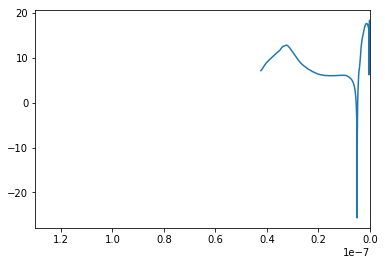

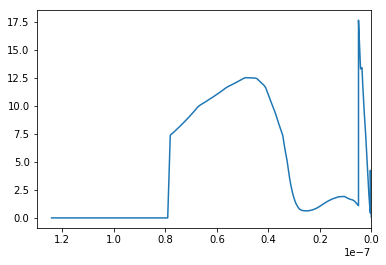

In [237]:
E = data[:, 0]
f_1 = data[:, 1]
f_2 = data[:, 2]

h = 6.63e-34
c = 3.0e8

lamda = h * c / (E * 1.602e-19)

from matplotlib import pyplot as plt

plt.figure()
plt.plot(lamda[f_1 > -100], f_1[f_1 > -100])
plt.xlim(130e-9, 0)
plt.show()

plt.figure()
plt.plot(lamda, f_2)#[f_1 > -100])
plt.xlim(130e-9, 0)
plt.show()

In [238]:
delta = (rho_0 * r_0 * lamda**2 / (2.0*np.pi)) * f_1
beta = (rho_0 * r_0 * lamda**2 / (2.0*np.pi)) * f_2

print(delta[np.isclose(E, 35, rtol=1e-2)][0], beta[np.isclose(E, 34.9557, rtol=1e-11)])

0.000175989764527 [ 0.00012435]


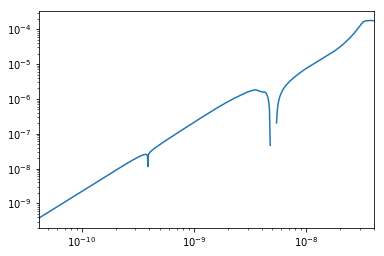

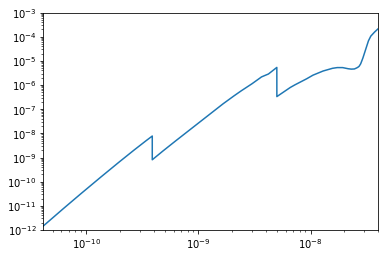

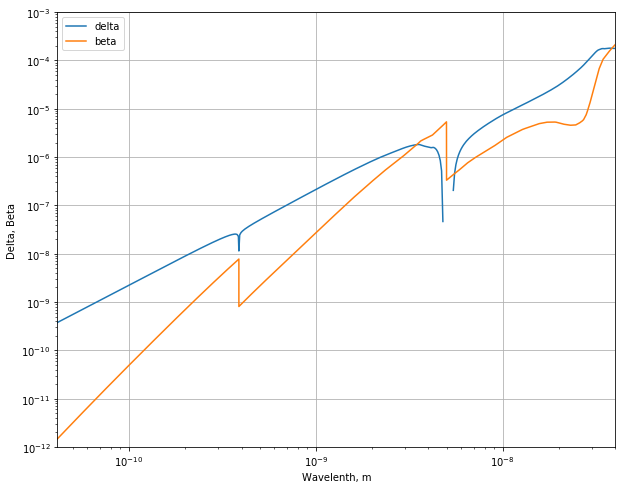

/home/sam/anaconda3/lib/python3.6/site-packages/numpy/core/numeric.py:531: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


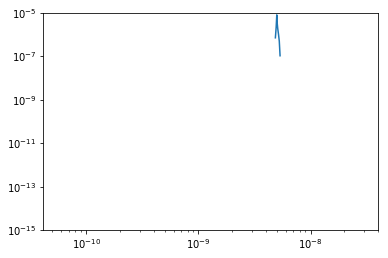

In [241]:
pressure = 100.0e-3
k_B = 1.381e-23

rho_0 = 2.715e25
#rho_0 = pressure * 1.0e5 / (k_B * 300.0)
r_0 = 2.8179e-15

n = 1 - (rho_0 * r_0 * lamda**2 / (2.0*np.pi)) * (f_1 + 1j*f_2)

plt.figure()
plt.loglog(lamda[::-1], delta[::-1])
plt.xlim(0, 40e-9)
#plt.ylim(0.01, 10)
plt.show()

plt.figure()
plt.loglog(lamda[::-1], beta[::-1])
plt.xlim(0, 40e-9)
plt.ylim(1e-12, 1e-3)
plt.show()

plt.figure(figsize=(10, 8))
plt.loglog(lamda[::-1], delta[::-1], label='delta')
plt.loglog(lamda[::-1], beta[::-1], label='beta')
plt.xlim(0, 40e-9)
plt.ylim(1e-12, 1e-3)
plt.xlabel('Wavelenth, m')
plt.ylabel('Delta, Beta')
plt.legend()
plt.grid()
plt.show()

plt.figure()
plt.loglog(lamda[::-1], (1 - delta - 1j*beta)[::-1] - 1)
plt.xlim(0, 40e-9)
plt.ylim(1e-15, 1e-5)
plt.show()

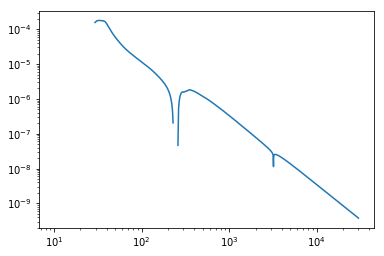

In [312]:
from scipy.interpolate import CubicSpline

cs = CubicSpline(E, delta)#, bc_type=((2, 0.0), (2, 0.0)))#(1 - delta - 1j*beta)[::-1])

x = np.linspace(1e-10, 120e-9, 1000000)

plt.figure()
plt.loglog(E, cs(E))
#plt.loglog(lamda[::-1], delta[::-1])
plt.show()

In [313]:
print(cs(35))
print(cs(10))

0.00017584784291531044
-1.876794204820133


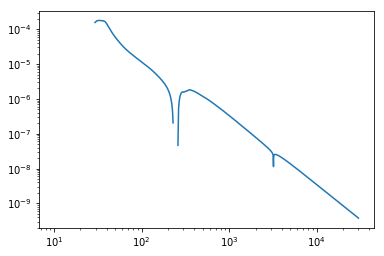

0.00017589719644519683


In [292]:
x = np.linspace(1e-10, 120e-9, 1000000)

from scipy.interpolate import interp1d
f = interp1d(E, delta)#lamda[::-1], delta[::-1])

plt.figure()
plt.loglog(E, f(E))
plt.show()

print(f(35))

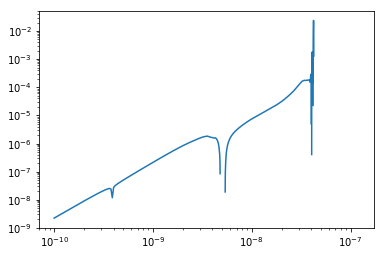

In [284]:
x = np.linspace(1e-10, 120e-9, 10000)

from scipy.interpolate import interp1d
f = interp1d(lamda[::-1], delta[::-1], kind='cubic')

plt.figure()
plt.loglog(x, f(x))
plt.show()

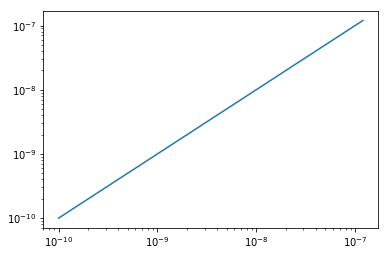

In [287]:
from scipy import interpolate

y = np.sin(x)
tck = interpolate.splrep(x, y, s=0)
xnew = np.linspace(1e-10, 120e-9, 10000)#np.arange(1e-10, 120e-9, np.pi/50)
ynew = interpolate.splev(xnew, tck, der=0)

plt.figure()
plt.loglog(xnew, ynew)
plt.show()

In [8]:
import numpy as np
import struct
from scipy.special import jn
import csv
from scipy.interpolate import interp1d

class HHG_prop():
    def __init__(self, N_r, radius,
                 N_z, Z):
        self._N_r = N_r
        self._radius = radius
        self._N_z = N_z
        self._Z = Z
        
        self._z = self._Z / self._N_z
        
        self._atomicScatteringFactorsFile = "../AtomicScatteringFactors/ar.nff"
        self._E = None
        self._f_1 = None
        self._f_2 = None
        
        self._h = 6.63e-34
        self._c = 3.0e8
        
        self._lamda = None
        
        self._pressure = 100.0e-3
        self._k_B = 1.381e-23

        #self._rho_0 = 2.715e25
        self._rho_0 = self._pressure * 1.0e5 / (self._k_B * 300.0)
        self._r_0 = 2.8179e-15
        
        self._readIn()
        self._set_hankel_transform()
        self._set_radial_grid()
        
    def _readIn(self):
        reader = csv.reader(open("../AtomicScatteringFactors/ar.nff"), delimiter="\t")

        data = []
        next(reader, None)
        for row in reader:
            data.append([row[0], row[1], row[2]])

        data = np.array(data, dtype=np.float64)

        self._E = data[:, 0]
        self._f_1 = data[:, 1]
        self._f_2 = data[:, 2]

        self._lamda = self._h * self._c / (self._E * 1.602e-19)
        
    def _delta(self, l):
        delta = (self._rho_0 * self._r_0 * self._lamda**2 / (2.0*np.pi)) * self._f_1
        
        f = interp1d(self._E, delta)
        E = self._h * self._c / l
        print('E:', E, 'l:', l)
        self._delta = f(E)
        #self._delta = delta[np.isclose(self._E, l, rtol=1e-2)][0]

    def _beta(self, l):
        beta = (self._rho_0 * self._r_0 * self._lamda**2 / (2.0*np.pi)) * self._f_2
        #self._beta = beta[np.isclose(E, l, rtol=1e-2)][0]
        
        f = interp1d(self._E, beta)
        E = self._h * self._c / l
        print('E:', E, 'l:', l)
        self._beta = f(E)
        
    def _n(self, l):
        #return 1.0
        return (1.0 - self._delta(l) - 1j*self._beta(l))
        
    def _set_hankel_transform(self):
        fileName = "input/J0_zeros.bin"
        f = open(fileName, mode='rb')

        N_radial_points = self._N_r
        max_norm = int(np.sqrt(self._N_r**2 + self._N_r**2)) + 1
        N_col = 1
        double_size = 8
        data = np.zeros(int(max_norm))
        content = f.read(double_size*int(max_norm))
        f.close()
        data_stream = struct.unpack("d"*int(max_norm), content)

        self._J0 = np.array(data_stream)
        self._H = np.zeros([self._N_r, self._N_r], dtype=complex)
        for i in range(self._N_r):
            for j in range(self._N_r):
                self._H[i, j] = (2.0 / self._J0[self._N_r]) * jn(0, (self._J0[j]*self._J0[i] / self._J0[self._N_r])) / jn(1, (self._J0[j]))**2
        self._H = np.array(self._H, dtype=complex)

    def _set_radial_grid(self):
        self._radial_grid = np.zeros(self._N_r)
        for i in range(self._N_r):
            self._radial_grid[i] = self._radius * self._J0[i] / self._J0[self._N_r]

    def _Hankel(self, E):
        # Hankel transform (just reusing the one in the postprocessing code)
        return self._H.dot(E)

    def _propagate(self, E_r_w, k_w):
        # Propagate each spectral amplitude from 0 to dz
        E_kr_w = np.zeros_like(E_r_w)
        E_r_w_propagated = np.zeros_like(E_r_w)
        for i in range(len(K[0, :])):
            k = np.ones(self._N_r)*k_w[i]
            k_r = self._J0[:self._N_r]/(self._radius)
            # Hankel transform
            E_kr_w[:, i] = self._Hankel(E_r_w[:, i])

            # Muliple by propagating exponential
            l = 2.0 * np.pi / k[0]
            E_kr_w[:, i] = E_kr_w[:, i] * np.exp(1j*self._z*np.sqrt(self._n(l)*k**2 - k_r**2))

            # Inverse Hankel transform
            E_r_w_propagated[:, i] = self._Hankel(E_kr_w[:, i])
            
            #E_r_w_propagated[-1,:] = 0.0
            for i in range(N_r):
                E_r_w_propagated[i, :] *= 1 - (np.sin(0.5 * np.pi * r[i] / radius))**50

        return E_r_w_propagated

    def Step_and_Source(self, E_P_r_w_source):
        # Propagate the spectral amplitudes from 0 to Z
        E_P_r_w = np.zeros_like(E_P_r_w_source)
        for i in range(np.shape(E_P_r_w)[0]):
            k_w = K[i]#np.copy(w[i, :]) / c
            if i == 0:
                E_P_r_w_prop = np.zeros_like(E_P_r_w_source[i])
            else:
                E_P_r_w_prop = self._propagate(E_P_r_w[i-1], k_w)
            E_P_r_w[i] = E_P_r_w_prop + E_P_r_w_source[i]

        return E_P_r_w

In [9]:
import numpy as np
from matplotlib import pyplot as plt
from scipy.fftpack import fft, ifft
#print(np.shape(multiple_runs._A_w_r))

read_in = True
if read_in == True:
    prop = HHG_prop(N_r=127, radius=75e-6,
                    N_z=100, Z=70e-3)
    E_P_r_w_source = np.copy(multiple_runs._A_w_r)
    E_P_r_w = np.zeros_like(E_P_r_w_source)
    
    w = multiple_runs._w_active[:, 0, :]
    K = w / 3.0e8
    
    n_active = np.shape(K)[1]
else:
    
    prop = HHG_prop(N_r=127*3, radius=150e-6,
                    N_z=200, Z=70e-3)
    
    N_z = prop._N_z
    N_r = prop._N_r
    radial_grid = prop._radial_grid
    r = radial_grid
    radius = prop._radius
    J0 = prop._J0
    Z = prop._Z
    N_z = prop._N_z
    
    
    #k = None
    k_r = None
    E_P_r_w = None
    E_kr_w = None

    c = 3.0e8
    l_0 = 800.0e-9
    w_0 = (2.0*np.pi*c)/l_0
    fwhm = 50.0e-15
    t = np.linspace(-fwhm*2.5, fwhm*2.5, 3000)

    print(np.shape(t))

    waist = 30.0e-6
    E_peak = 30e16
    E_P_r_t_source = np.zeros([N_z, N_r, 3000])
    for i in range(N_r):
        E_P_r_t_source[0, i, :] = np.exp(-2.77*(t/fwhm)**2) * np.exp(-1j*w_0*t) 
        E_P_r_t_source[0, i, :] *= np.exp(-(radial_grid[i]/waist)**2)
        
        E_P_r_t_source[0, i, :100] *= 0
        E_P_r_t_source[0, i, -100] *= 0
        
    E_P_r_t_source *= E_peak
    
    for i in range(N_r):
        E_P_r_t_source[0, i, :] *= 1 - (np.sin(0.5 * np.pi * r[i] / radius))**50

    w = np.zeros([N_z, 1500])
    for i in range(N_z):
        for j in range(1500):
            w[i, j] = 2.0*np.pi / t[1500+j]
    K = w / c

    Kr_max = J0[N_r]/radius

    n_active = 0
    loop = True
    while loop:
        if K[0, n_active] > Kr_max:
            n_active = n_active+1
        else:
            loop = False
            n_active = n_active-1

    K = K[:, :n_active]

    plt.figure()
    plt.plot(t, (E_P_r_t_source[0, 60, :]).T)
    plt.show()
    
    plt.figure()
    plt.plot(r, (E_P_r_t_source[0, :, 1500]).T)
    plt.show()
    
    E_P_r_w_source = fft(E_P_r_t_source)[:, :, 1500:1500+n_active]
    E_P_r_w_source[1:] *= 0.0

    plt.figure()
    plt.plot(w[0, :n_active], E_P_r_w_source[0, 60, :])
    #plt.xlim(0.6e14, 0.8e14)
    plt.show()

E_P_r_w = prop.Step_and_Source(E_P_r_w_source)

1.329722082e-18


ValueError: A value in x_new is below the interpolation range.

In [4]:
from matplotlib import pyplot as plt

x = np.linspace(0, Z, N_z)
y = radial_grid*1.0e6#range(127)
z = np.real(np.sum(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]),axis=2))

z_2 = np.real(np.trapz(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]),axis=2))

#z_3 = np.real(np.trapz(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]), x=w[0,:n_active], axis=2))
#z_3 = np.real(np.conj(E_P_r_w[:, :, test])*E_P_r_w[:, :, test])[:, :, 0, 0]

z_r = np.zeros_like(z)
for j in range(100):
    for i in range(127):
        z_r[j, i] = z[j, i] * multiple_runs._radial_grid[i] / multiple_runs._radius

plt.figure(figsize=(10, 8))
plt.plot(x, z_2)#[:, [0, 40, 80]])
plt.xlabel("Propagation Distance, m")
plt.ylabel("Intensity")
plt.show()

plt.figure(figsize=(10, 8))
plt.pcolor(x, y, z.T)
plt.colorbar()
plt.xlabel("Propagation Distance, m")
plt.ylabel("Radial Distance, um")
plt.grid()
plt.show()

plt.figure(figsize=(10, 8))
plt.pcolor(x, y, z_r.T)
plt.colorbar()
plt.xlabel("Propagation Distance, m")
plt.ylabel("Radial Distance, um")
plt.grid()
plt.show()

NameError: name 'multiple_runs' is not defined

In [5]:
from matplotlib import pyplot as plt

x = np.linspace(0, Z, N_z)
y = radial_grid*1.0e6#range(127)
z = np.real(np.sum(np.abs(np.conj(E_P_r_w[:, :, w_range_min:w_range_max])*E_P_r_w[:, :, w_range_min:w_range_max]),axis=2))

z_2 = np.real(np.trapz(np.abs(np.conj(E_P_r_w[:, :, w_range_min:w_range_max])*E_P_r_w[:, :, w_range_min:w_range_max]),axis=2))

#z_3 = np.real(np.trapz(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]), x=w[0,:n_active], axis=2))
#z_3 = np.real(np.conj(E_P_r_w[:, :, test])*E_P_r_w[:, :, test])[:, :, 0, 0]

z_r = np.zeros_like(z)
for j in range(100):
    for i in range(127):
        z_r[j, i] = z[j, i] * multiple_runs._radial_grid[i] / multiple_runs._radius

plt.figure(figsize=(10, 8))
plt.plot(x, z_2)#[:, [0, 40, 80]])
plt.xlabel("Propagation Distance, m")
plt.ylabel("Intensity")
plt.show()

plt.figure(figsize=(10, 8))
plt.pcolor(x, y, z.T)
plt.colorbar()
plt.xlabel("Propagation Distance, m")
plt.ylabel("Radial Distance, um")
plt.grid()
plt.show()

plt.figure(figsize=(10, 8))
plt.pcolor(x, y, z_r.T)
plt.colorbar()
plt.xlabel("Propagation Distance, m")
plt.ylabel("Radial Distance, um")
plt.grid()
plt.show()

NameError: name 'w_range_min' is not defined

(200, 381, 30)


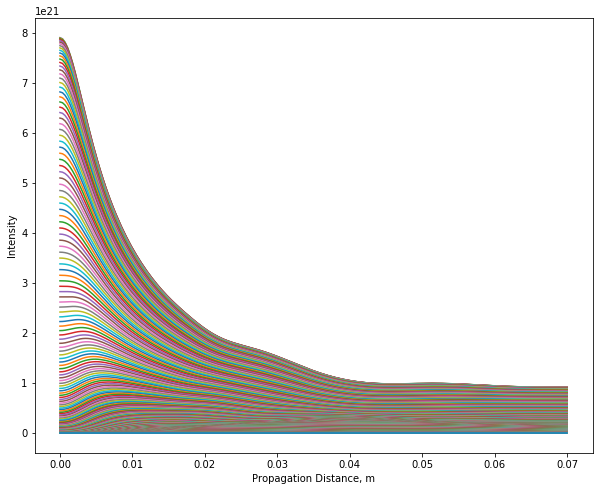

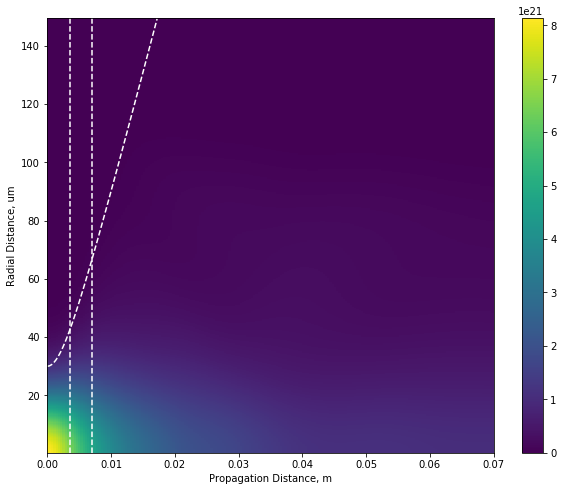

In [44]:
from matplotlib import pyplot as plt

print(np.shape(E_P_r_w))
x = np.linspace(0, Z, N_z)
y = radial_grid*1.0e6#range(127)
z = np.real(np.sum(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]),axis=2))

z_2 = np.real(np.trapz(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]),axis=2))

z_3 = np.real(np.trapz(np.abs(np.conj(E_P_r_w[:, :])*E_P_r_w[:, :]), x=w[0,:n_active], axis=2))
#z_3 = np.real(np.conj(E_P_r_w[:, :, test])*E_P_r_w[:, :, test])[:, :, 0, 0]

Rayleigh_length = np.pi*1.0*waist**2/(l_0)
spot_size = waist * np.sqrt(1.0 + (x / Rayleigh_length)**2) * 1e6

plt.figure(figsize=(10, 8))
plt.plot(x, z_2)#[:, [0, 40, 80]])
plt.xlabel("Propagation Distance, m")
plt.ylabel("Intensity")
plt.show()

plt.figure(figsize=(10, 8))
plt.pcolor(x, y, z.T)
plt.plot(x[spot_size < np.max(y)], spot_size[spot_size < np.max(y)], 'w--')
plt.plot([Rayleigh_length, Rayleigh_length], [y[0], y[-1]], 'w--')
plt.plot([Rayleigh_length*2, Rayleigh_length*2], [y[0], y[-1]], 'w--')
plt.colorbar()
plt.xlabel("Propagation Distance, m")
plt.ylabel("Radial Distance, um")
plt.show()

In [6]:
print("Rayleigh_length: ", Rayleigh_length)

Z / N_z

Rayleigh_length:  0.0035342917352885173


1e-05

In [18]:
save_1 = z[0]
print(Z / N_z *1)

1e-09


In [26]:
save_2 = z[1]
print(Z / N_z *100)

5.0000000000000004e-08


In [6]:
save_3 = z[150]
print(Z / N_z *150)

0.00075


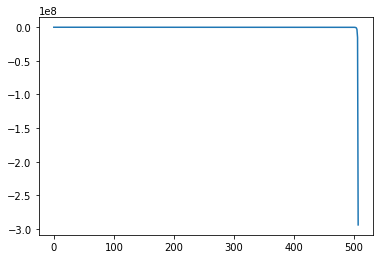

In [27]:
plt.figure()
plt.plot((save_2 - save_1) / save_2)
plt.show()

/home/sam/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


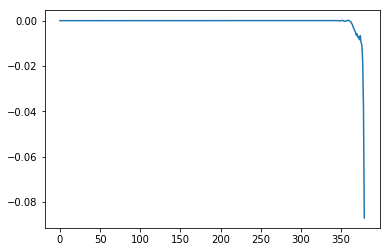

In [30]:
plt.figure()
plt.plot((save_3 - save_1) / save_3)
plt.show()

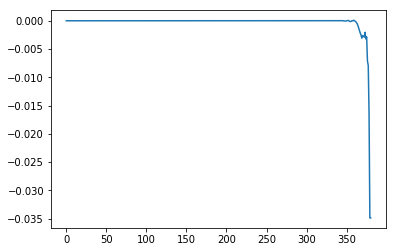

In [8]:
plt.figure()
plt.plot((save_3 - save_2) / save_3)
plt.show()

(200, 381)


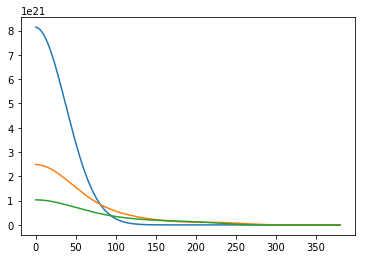

In [45]:
print(np.shape(z))

plt.figure()
plt.plot(z[0])
#plt.plot(z[10])
#plt.plot(z[100])
plt.plot(z[50])
#plt.plot(z[700])
#plt.plot(z[800])
#plt.plot(z[900])
plt.plot(z[-1])
plt.show()

In [46]:
fit = np.zeros_like(z)

for i in range(len(z)):
    fit[i] = (np.sqrt(np.max(z[i])) * np.exp(-(r*1e6/spot_size[i])**2))**2

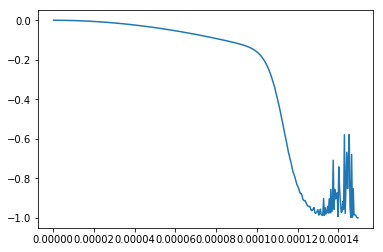

In [47]:
i = 1

tmp = (z[i] - fit[i]) / fit[i]
plt.figure()
plt.plot(r, tmp)
#plt.plot(r[tmp <= 0.01], tmp[tmp <= 0.01])
plt.show()

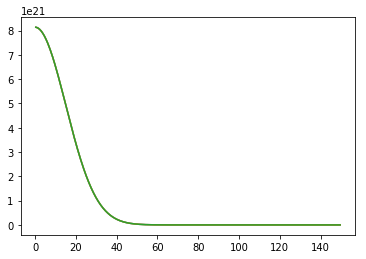

In [48]:
fit_0 = np.sqrt(np.max(z[0])) * np.exp(-(r/waist)**2)

plt.figure()
plt.plot(r*1e6, z[0])
plt.plot(r*1e6, fit_0**2)
plt.plot(r*1e6, fit[0])
plt.show()

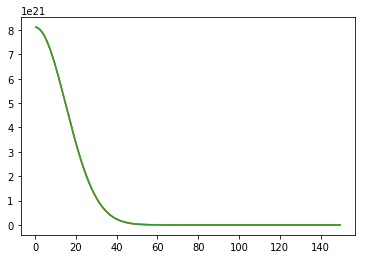

In [49]:
fit_1 = np.sqrt(np.max(z[1])) * np.exp(-(r/waist)**2)

plt.figure()
plt.plot(r*1e6, z[1])
plt.plot(r*1e6, fit_1**2)
plt.plot(r*1e6, fit[1])
plt.show()

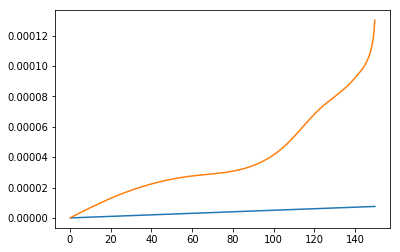

In [50]:
i = -1

#tmp = waist * np.sqrt(-1*np.log(np.sqrt(fit_1)/np.sqrt(np.max(z[i]))))
tmp = waist * np.sqrt(-1*np.log(np.sqrt(fit[i]) / np.sqrt(np.max(z[i]))))

tmp_z = waist * np.sqrt(-1*np.log(np.sqrt(z[i]) / np.sqrt(np.max(z[i]))))

plt.figure()
plt.plot(r*1e6, tmp)
plt.plot(r*1e6, tmp_z)
plt.show()

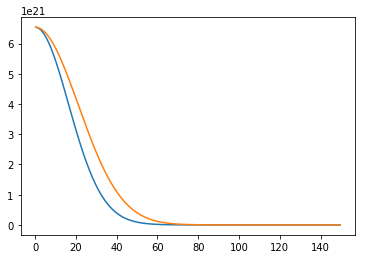

In [51]:
fit_10 = np.sqrt(np.max(z[10])) * np.exp(-(r*1e6/spot_size[10])**2)

plt.figure()
plt.plot(r*1e6, z[10])
plt.plot(r*1e6, fit_10**2)
plt.show()

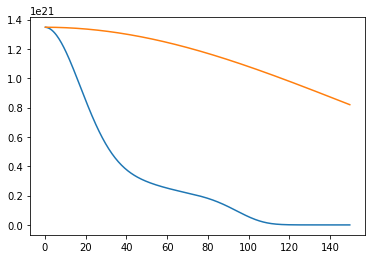

In [52]:
fit_100 = np.sqrt(np.max(z[100])) * np.exp(-(r*1e6/spot_size[100])**2)

plt.figure()
plt.plot(r*1e6, z[100])
plt.plot(r*1e6, fit_100**2)
plt.show()

In [22]:
fit_500 = np.sqrt(np.max(z[500])) * np.exp(-(r*1e6/spot_size[500])**2)

plt.figure()
plt.plot(r*1e6, z[500])
plt.plot(r*1e6, fit_500**2)
plt.show()

IndexError: index 500 is out of bounds for axis 0 with size 500

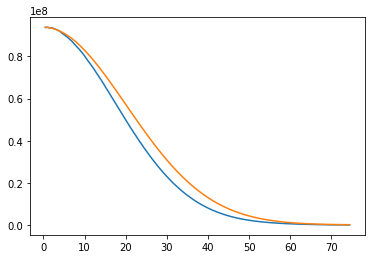

In [10]:
fit_900 = np.sqrt(np.max(z[900])) * np.exp(-(r*1e6/spot_size[900])**2)

plt.figure()
plt.plot(r*1e6, z[900])
plt.plot(r*1e6, fit_900**2)
plt.show()

In [31]:
fit = np.zeros_like(z)

for i in range(len(z)):
    fit[i] = np.sqrt(np.max(z[i])) * np.exp(-(r*1e6/spot_size[i])**2)

In [53]:
import scipy.stats

def rsquared(x, y):
    """ Return R^2 where x and y are array-like."""

    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
    return r_value**2

In [54]:
np.sqrt(0.937)

print(rsquared(np.log(z[1]), np.log(fit[1])))

0.996632171487


In [55]:
r_125 = np.zeros(len(z))

for i in range(len(z)):
    r_125[i] = rsquared(np.log(z[i]), np.log(fit[i]))
    
print(r_125[0])

0.99204176042


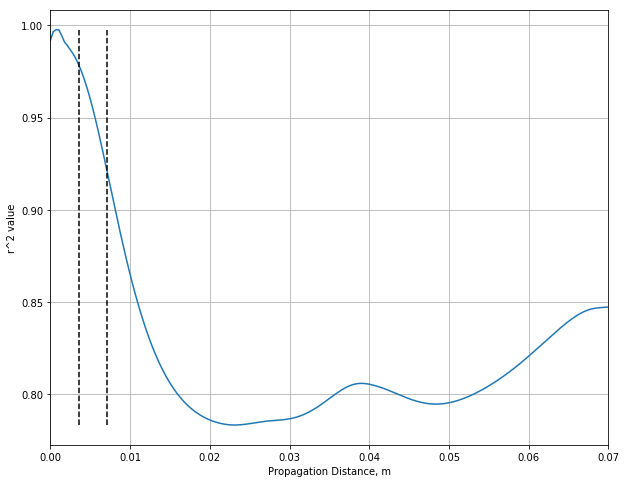

In [56]:
# For a radius of 125um

plt.figure(figsize=(10, 8))
plt.plot(x, r_125)
plt.plot([Rayleigh_length, Rayleigh_length], [r_125.min(), r_125.max()], 'k--')
plt.plot([Rayleigh_length*2, Rayleigh_length*2], [r_125.min(), r_125.max()], 'k--')
plt.xlabel("Propagation Distance, m")
plt.ylabel("r^2 value")
plt.xlim(0, Z)#Rayleigh_length*40)
#plt.ylim(0, 1)
plt.grid()
plt.show()

In [50]:
r_150 = np.zeros(1000)

for i in range(1000):
    r_150[i] = rsquared(z[i], fit[i])

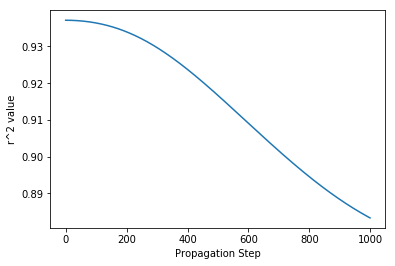

In [51]:
# For a radius of 150um

plt.figure()
plt.plot(r_150)
plt.xlabel("Propagation Step")
plt.ylabel("r^2 value")
plt.show()

In [67]:
r_100 = np.zeros(1000)

for i in range(1000):
    r_100[i] = rsquared(z[i], fit[i])

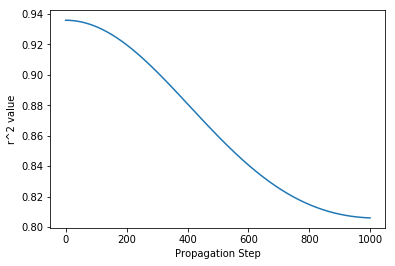

In [69]:
# For a radius of 100um

plt.figure()
plt.plot(r_100)
plt.xlabel("Propagation Step")
plt.ylabel("r^2 value")
plt.show()

In [83]:
r_75 = np.zeros(1000)

for i in range(1000):
    r_75[i] = rsquared(z[i], fit[i])

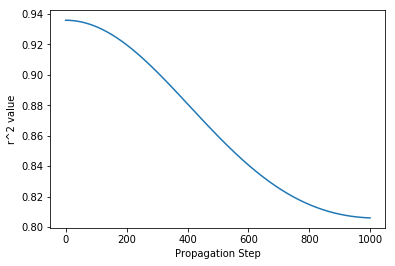

In [84]:
# For a radius of 100um

plt.figure()
plt.plot(r_100)
plt.xlabel("Propagation Step")
plt.ylabel("r^2 value")
plt.show()

In [101]:
r_300 = np.zeros(1000)

for i in range(1000):
    r_300[i] = rsquared(z[i], fit[i])

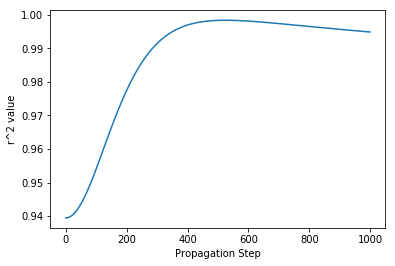

In [102]:
# For a radius of 100um

plt.figure()
plt.plot(r_300)
plt.xlabel("Propagation Step")
plt.ylabel("r^2 value")
plt.show()

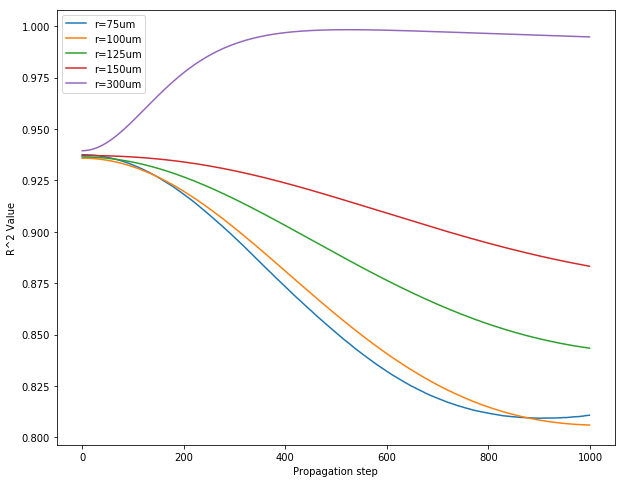

In [106]:
plt.figure(figsize=(10,8))
plt.plot(r_75, label="r=75um")
plt.plot(r_100, label="r=100um")
plt.plot(r_125, label="r=125um")
plt.plot(r_150, label="r=150um")
plt.plot(r_300, label="r=300um")
plt.xlabel("Propagation step")
plt.ylabel("R^2 Value")
plt.legend()
plt.show()

In [1]:
from UPPEPostprocessing import UPPE
import numpy as np

x_range = (0.0035, 0.070)

sim_run = "001"
path = "./output/"
#path = "../../Results/UPPE/5fsFWHM/zeroPressure_lowPower_nz200_20modes/data/"+sim_run+"/"
#path = "../../Results/UPPE/5fsFWHM/zeroPressure_nz1000/data/"+sim_run+"/"
prop_step = 1

start_position = 0.0
finish_position = 0.0750
n_z = 100

prop_step = 1
step_size = 1
files_A_w_R = np.array(path+sim_run+"_"+str(prop_step)+"_A_w_R.bin")
files_A_w_I = np.array(path+sim_run+"_"+str(prop_step)+"_A_w_I.bin")
files_w_active = np.array(path+sim_run+"_"+str(prop_step)+"_w_active.bin")
files_electronDensity = np.array(path+sim_run+"_"+str(prop_step)+"_electron_density.bin")

labels = np.array(str((finish_position - start_position) / n_z * prop_step))

for i in range(2, n_z+1, step_size):
    prop_step = i
    
    files_A_w_R = np.vstack((files_A_w_R, (path+sim_run+"_"+str(prop_step)+"_A_w_R.bin")))
    files_A_w_I = np.vstack((files_A_w_I, (path+sim_run+"_"+str(prop_step)+"_A_w_I.bin")))
    files_w_active = np.vstack((files_w_active, (path+sim_run+"_"+str(prop_step)+"_w_active.bin")))
    files_electronDensity = np.vstack((files_electronDensity, (path+sim_run+"_"+str(prop_step)+"_electron_density.bin")))

    labels = np.vstack((labels, np.array(str((finish_position - start_position) / n_z * prop_step))))
    
files = {"A_w_R":files_A_w_R,
         "A_w_I":files_A_w_I,
         "w_active":files_w_active,
         "ionisation":files_electronDensity}

parameters = {"N_t":16384,  # To match the UPPE config file
              "radius":75.0e-6,
              "Z":0.07,
              "Z_min":0.0035,
              "N_z":n_z,
              "w_active_min_index":32}

SyntaxError: invalid syntax (UPPEPostprocessing.py, line 1089)

In [2]:
multiple_runs = UPPE(files=files, parameters=parameters, labels=labels)

In [7]:
header = {'Format': '',
          'Version': 0,
          'Subversion': 0,
          'Header_size': 0,
          'N_row': 0,
          'N_col': 0,
          'Data_size': 0,
          'Double_size': 0}

ion_test, header = multiple_runs.data._read_in_data('./bin/ionisation_rate_test.bin', header)

FileNotFoundError: [Errno 2] No such file or directory: './bin/ionisation_rate_test.bin'

0.0


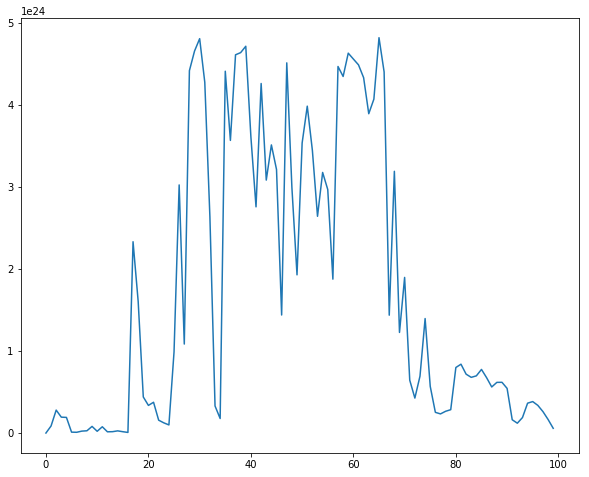

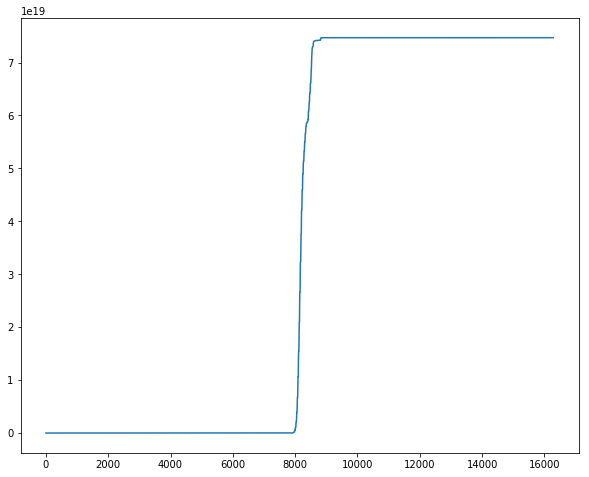

In [19]:
from matplotlib import pyplot as plt

y = np.copy(multiple_runs._electronDensity)

print(y[0, 0, -100])

plt.figure(figsize=(10, 8))
#plt.plot(y[50, :, :-100].T)
plt.plot(y[:, 0, -100].T)
#plt.ylim(1e22, 4e23)
plt.show()

i = 0
for r in multiple_runs._radial_grid:
    y[:, i, :] *= r
    i += 1
    
y3 = np.sum(y, axis=1)

plt.figure(figsize=(10, 8))
plt.plot(y3[50, :-100].T)
plt.show()

In [18]:
np.shape(y)

(100, 50, 16384)

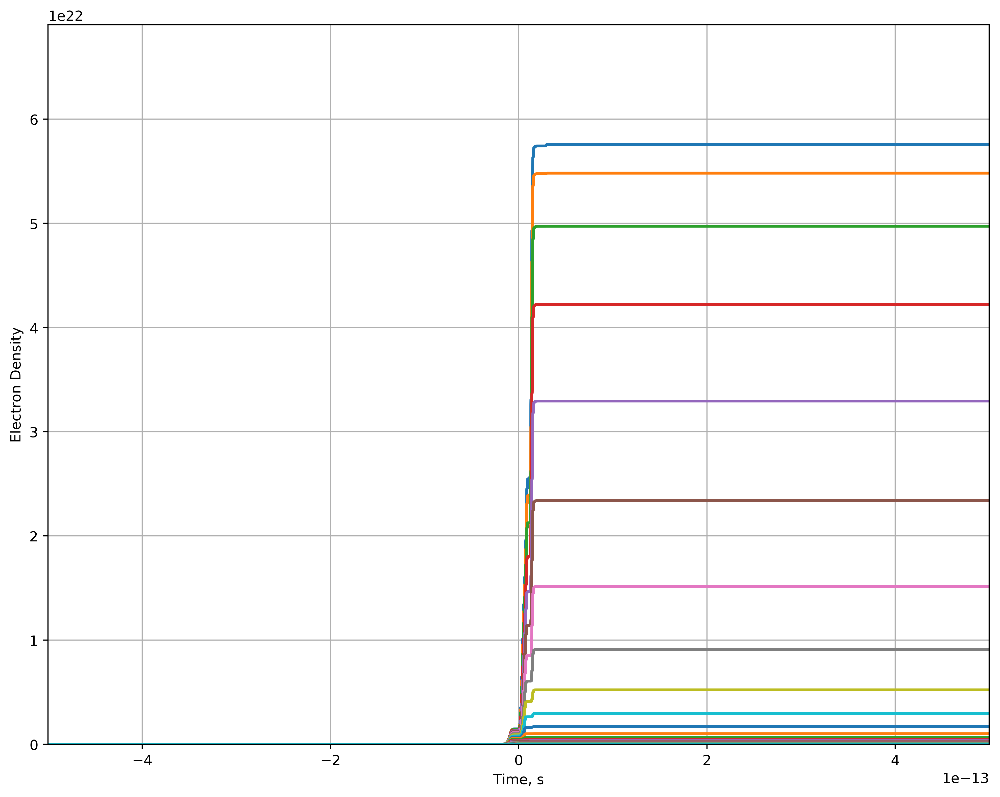

In [4]:
multiple_runs.plot.combined_propagationDistance_electronDensity(radially_weighted=False)

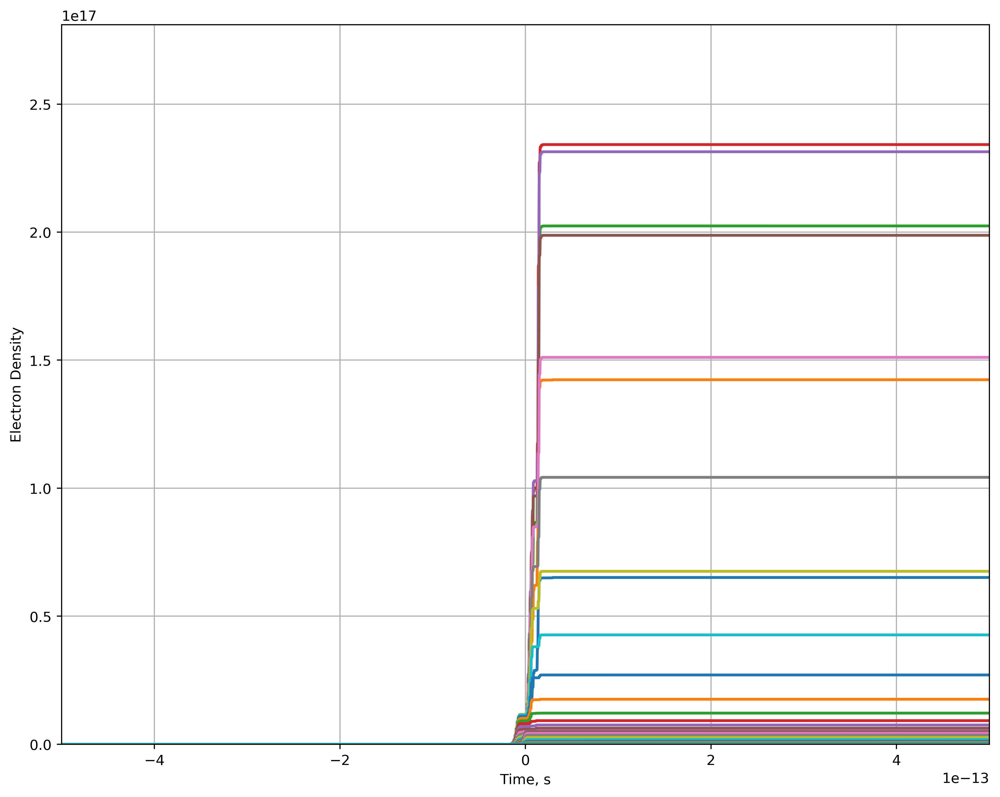

In [5]:
multiple_runs.plot.combined_propagationDistance_electronDensity(radially_weighted=True)

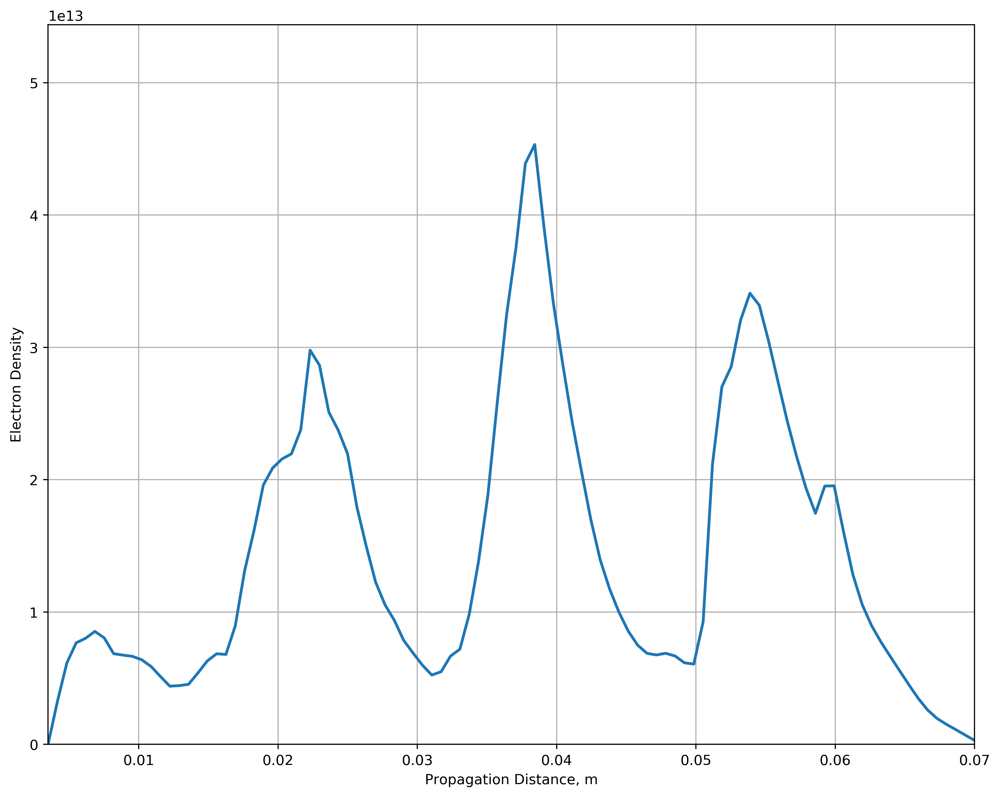

In [5]:
multiple_runs.plot.combined_propagationDistance_electronDensity(radially_integrated=True)

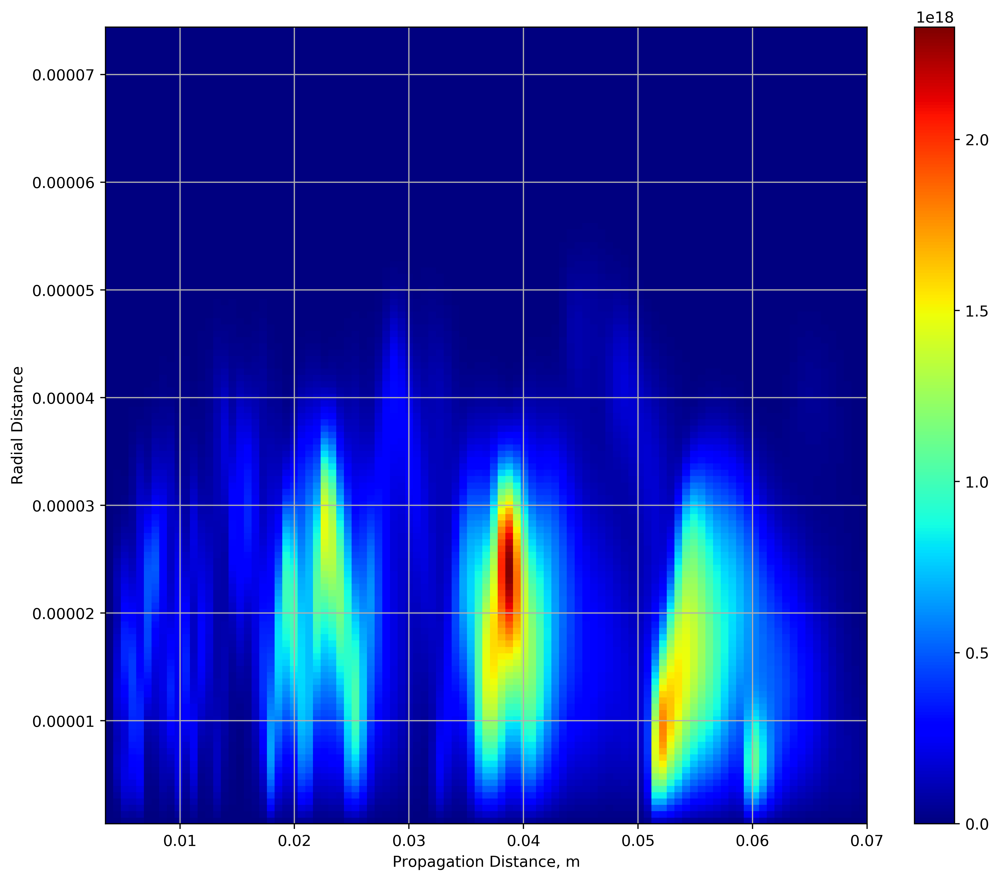

In [8]:
multiple_runs.plot.combined_propagationDistance_electronDensity_colourMap(radially_weighted=True)

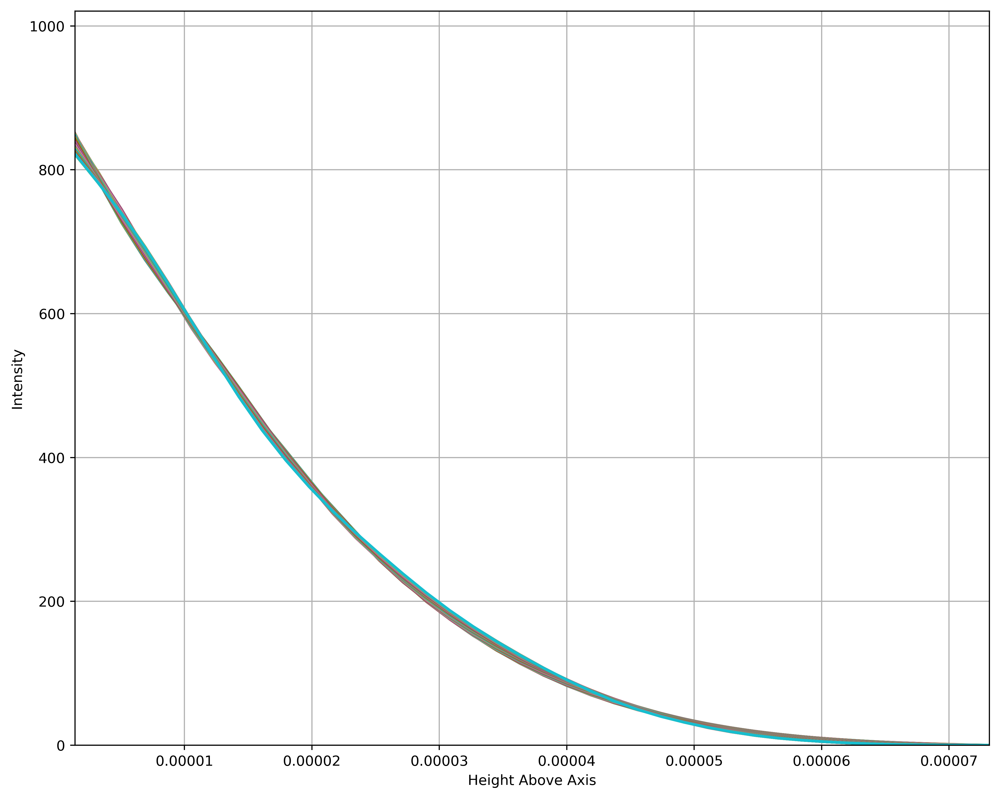

In [5]:
multiple_runs.plot.combined_radial_integration()

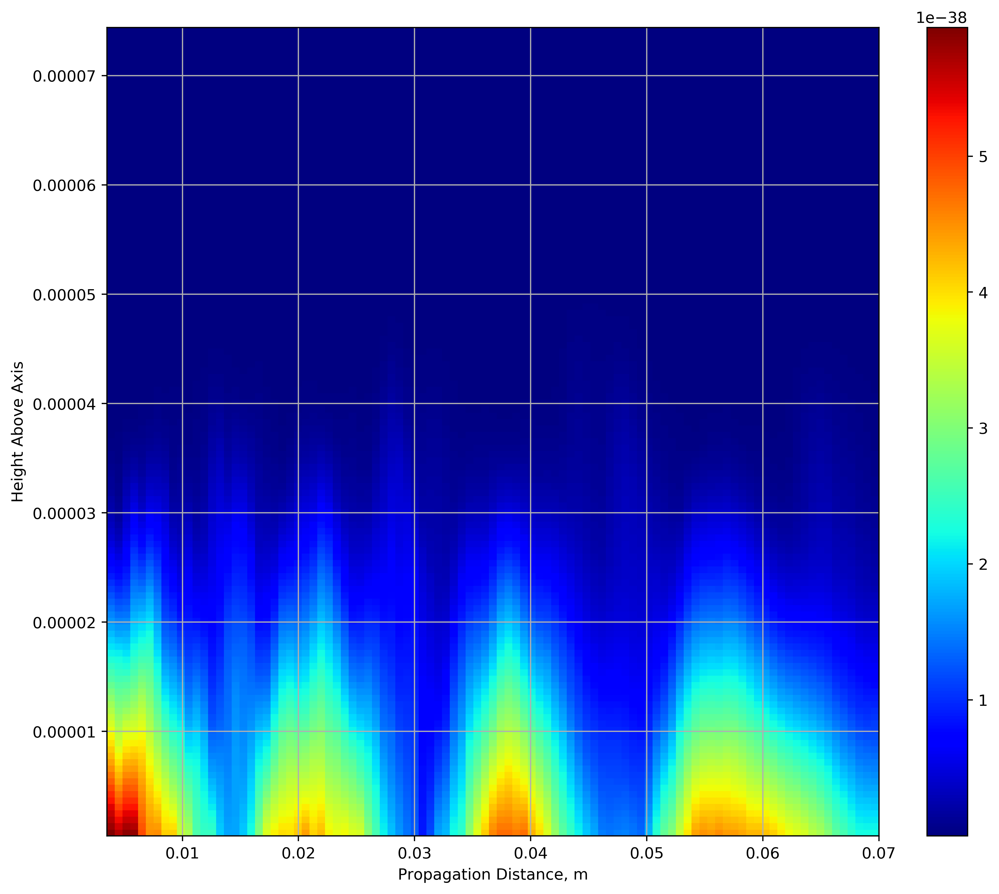

In [3]:
multiple_runs.plot.combined_radial_integration_colourMap(x_range=x_range)

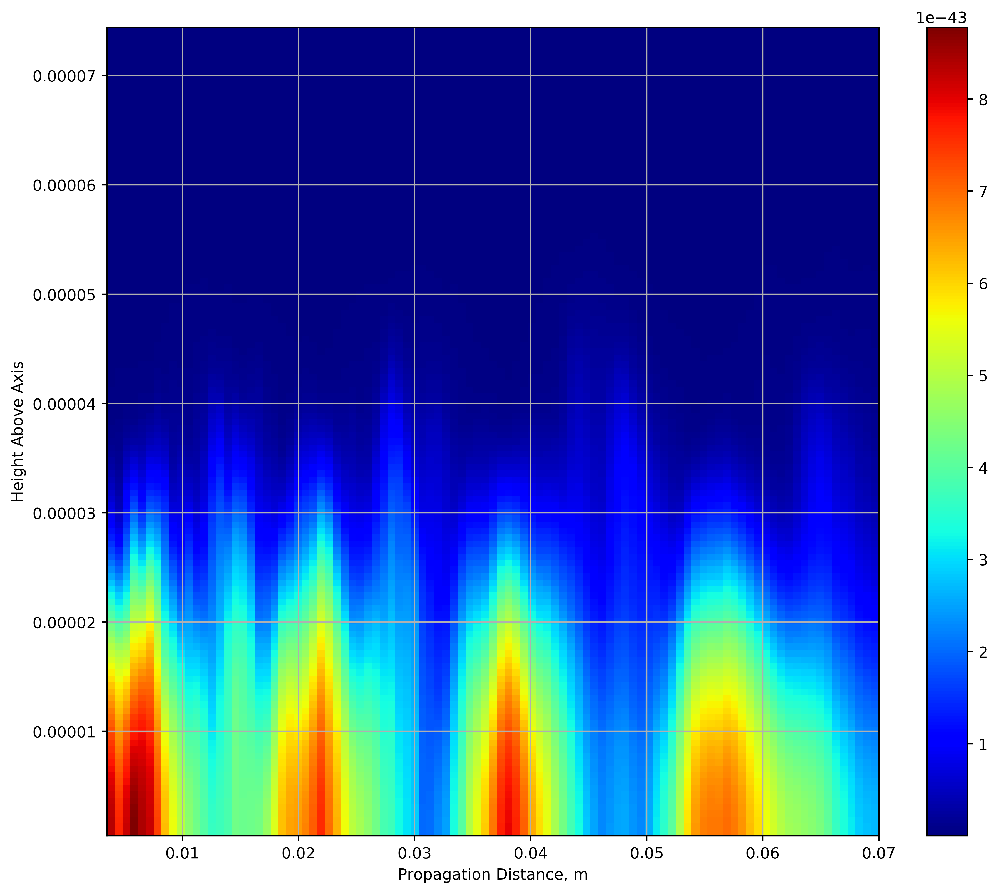

In [4]:
multiple_runs.plot.combined_radial_integration_colourMap(x_range=x_range,
                                                         radially_weighted=True)

In [3]:
files = np.array(((path+sim_run+"_5_A_w_R.bin", path+sim_run+"_5_A_w_I.bin", path+sim_run+"_5_w_active.bin"),
                  (path+sim_run+"_10_A_w_R.bin", path+sim_run+"_10_A_w_I.bin", path+sim_run+"_10_w_active.bin"),
                  (path+sim_run+"_15_A_w_R.bin", path+sim_run+"_15_A_w_I.bin", path+sim_run+"_15_w_active.bin"),
                  (path+sim_run+"_20_A_w_R.bin", path+sim_run+"_20_A_w_I.bin", path+sim_run+"_20_w_active.bin"),
                  (path+sim_run+"_25_A_w_R.bin", path+sim_run+"_25_A_w_I.bin", path+sim_run+"_25_w_active.bin"),
                  (path+sim_run+"_30_A_w_R.bin", path+sim_run+"_30_A_w_I.bin", path+sim_run+"_30_w_active.bin"),
                  (path+sim_run+"_35_A_w_R.bin", path+sim_run+"_35_A_w_I.bin", path+sim_run+"_35_w_active.bin"),
                  (path+sim_run+"_40_A_w_R.bin", path+sim_run+"_40_A_w_I.bin", path+sim_run+"_40_w_active.bin"),
                  (path+sim_run+"_45_A_w_R.bin", path+sim_run+"_45_A_w_I.bin", path+sim_run+"_45_w_active.bin"),
                  (path+sim_run+"_50_A_w_R.bin", path+sim_run+"_50_A_w_I.bin", path+sim_run+"_50_w_active.bin"),
                  (path+sim_run+"_55_A_w_R.bin", path+sim_run+"_55_A_w_I.bin", path+sim_run+"_55_w_active.bin"),
                  (path+sim_run+"_60_A_w_R.bin", path+sim_run+"_60_A_w_I.bin", path+sim_run+"_60_w_active.bin"),
                  (path+sim_run+"_65_A_w_R.bin", path+sim_run+"_65_A_w_I.bin", path+sim_run+"_65_w_active.bin"), 
                  (path+sim_run+"_70_A_w_R.bin", path+sim_run+"_70_A_w_I.bin", path+sim_run+"_70_w_active.bin"),
                  (path+sim_run+"_75_A_w_R.bin", path+sim_run+"_75_A_w_I.bin", path+sim_run+"_75_w_active.bin"),
                  (path+sim_run+"_80_A_w_R.bin", path+sim_run+"_80_A_w_I.bin", path+sim_run+"_80_w_active.bin"),
                  (path+sim_run+"_85_A_w_R.bin", path+sim_run+"_85_A_w_I.bin", path+sim_run+"_85_w_active.bin"),
                  (path+sim_run+"_90_A_w_R.bin", path+sim_run+"_90_A_w_I.bin", path+sim_run+"_90_w_active.bin"),
                  (path+sim_run+"_95_A_w_R.bin", path+sim_run+"_95_A_w_I.bin", path+sim_run+"_95_w_active.bin"),
                  (path+sim_run+"_100_A_w_R.bin", path+sim_run+"_100_A_w_I.bin", path+sim_run+"_100_w_active.bin")))

print(np.shape(files))

NameError: name 'np' is not defined

In [8]:
import numpy as np

sim_run = "000"
path = "./output/increasingPower/"
#path = "./output/"

files = np.array(((path+sim_run+"_5_A_w_R.bin", path+sim_run+"_5_A_w_I.bin", path+sim_run+"_5_w_active.bin"),
                  (path+sim_run+"_10_A_w_R.bin", path+sim_run+"_10_A_w_I.bin", path+sim_run+"_10_w_active.bin"),
                  (path+sim_run+"_15_A_w_R.bin", path+sim_run+"_15_A_w_I.bin", path+sim_run+"_15_w_active.bin"),
                  (path+sim_run+"_20_A_w_R.bin", path+sim_run+"_20_A_w_I.bin", path+sim_run+"_20_w_active.bin"),
                  (path+sim_run+"_25_A_w_R.bin", path+sim_run+"_25_A_w_I.bin", path+sim_run+"_25_w_active.bin"),
                  (path+sim_run+"_30_A_w_R.bin", path+sim_run+"_30_A_w_I.bin", path+sim_run+"_30_w_active.bin"),
                  (path+sim_run+"_35_A_w_R.bin", path+sim_run+"_35_A_w_I.bin", path+sim_run+"_35_w_active.bin"),
                  (path+sim_run+"_40_A_w_R.bin", path+sim_run+"_40_A_w_I.bin", path+sim_run+"_40_w_active.bin"),
                  (path+sim_run+"_45_A_w_R.bin", path+sim_run+"_45_A_w_I.bin", path+sim_run+"_45_w_active.bin"),
                  (path+sim_run+"_50_A_w_R.bin", path+sim_run+"_50_A_w_I.bin", path+sim_run+"_50_w_active.bin"),
                  (path+sim_run+"_55_A_w_R.bin", path+sim_run+"_55_A_w_I.bin", path+sim_run+"_55_w_active.bin"),
                  (path+sim_run+"_60_A_w_R.bin", path+sim_run+"_60_A_w_I.bin", path+sim_run+"_60_w_active.bin"),
                  (path+sim_run+"_65_A_w_R.bin", path+sim_run+"_65_A_w_I.bin", path+sim_run+"_65_w_active.bin"), 
                  (path+sim_run+"_70_A_w_R.bin", path+sim_run+"_70_A_w_I.bin", path+sim_run+"_70_w_active.bin"),
                  (path+sim_run+"_75_A_w_R.bin", path+sim_run+"_75_A_w_I.bin", path+sim_run+"_75_w_active.bin"),
                  (path+sim_run+"_80_A_w_R.bin", path+sim_run+"_80_A_w_I.bin", path+sim_run+"_80_w_active.bin"),
                  (path+sim_run+"_85_A_w_R.bin", path+sim_run+"_85_A_w_I.bin", path+sim_run+"_85_w_active.bin"),
                  (path+sim_run+"_90_A_w_R.bin", path+sim_run+"_90_A_w_I.bin", path+sim_run+"_90_w_active.bin"),
                  (path+sim_run+"_95_A_w_R.bin", path+sim_run+"_95_A_w_I.bin", path+sim_run+"_95_w_active.bin"),
                  (path+sim_run+"_100_A_w_R.bin", path+sim_run+"_100_A_w_I.bin", path+sim_run+"_100_w_active.bin")))
labels = (r"0.0035m",
          r"0.0070m",
          r"0.0105m",
          r"0.0140m",
          r"0.0175m",
          r"0.0210m",
          r"0.0245m",
          r"0.0280m",
          r"0.0315m",
          r"0.0350m",
          r"0.0385m",
          r"0.0420m",
          r"0.0455m",
          r"0.0490m",
          r"0.0525m",
          r"0.0560m",
          r"0.0595m",
          r"0.0630m",
          r"0.0665m",
          r"0.0700m")

multiple_runs = UPPE.multi(files, labels)

FileNotFoundError: [Errno 2] No such file or directory: './output/increasingPower/1_5_A_w_R.bin'

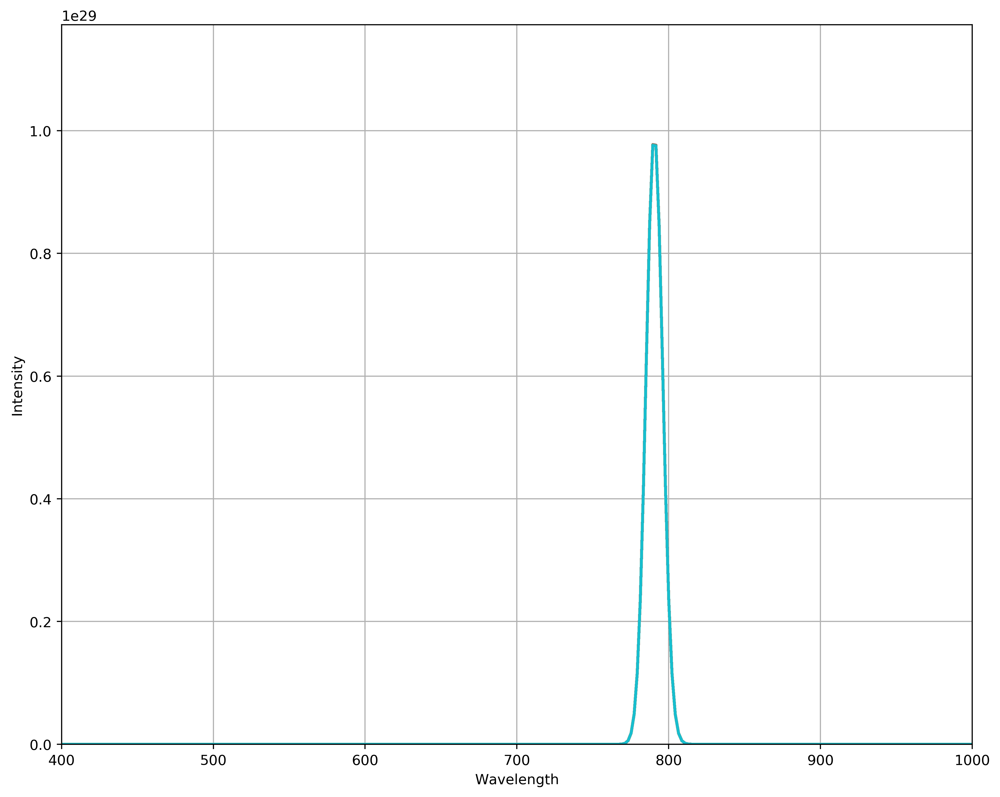

In [8]:
multiple_runs.plot.combined_intensity_wavelength(xlim=(400, 1000),
                                                 representation="mode")

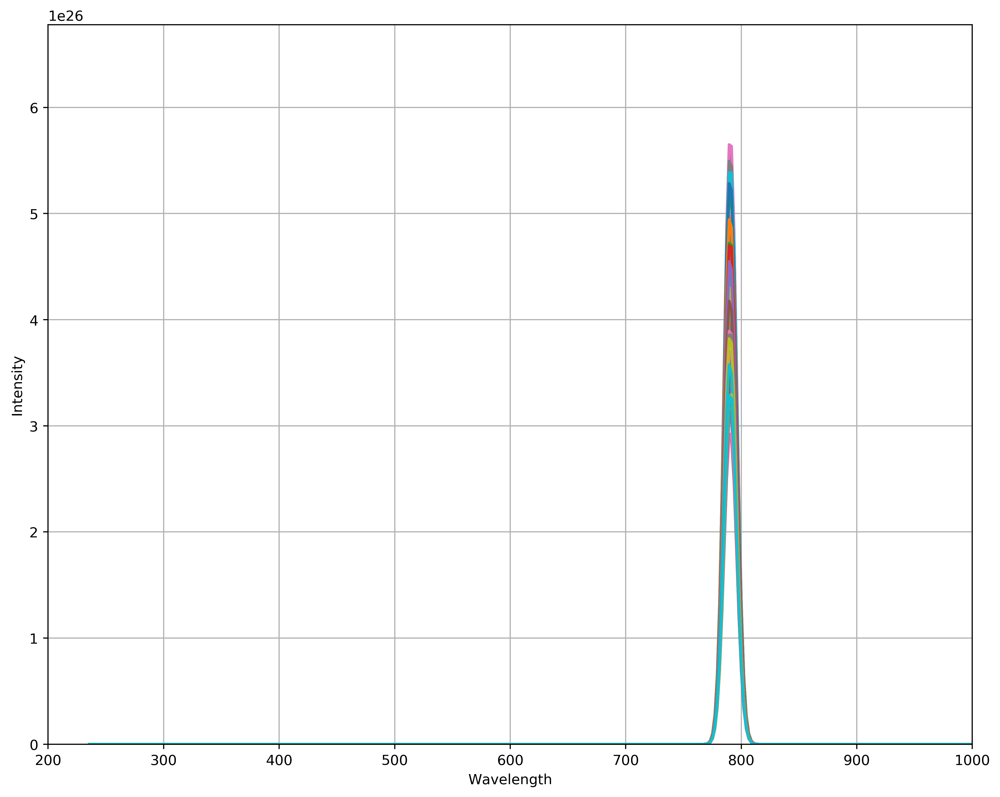

In [9]:
multiple_runs.plot.combined_intensity_wavelength(xlim=(200, 1000),
                                                 representation="radial")

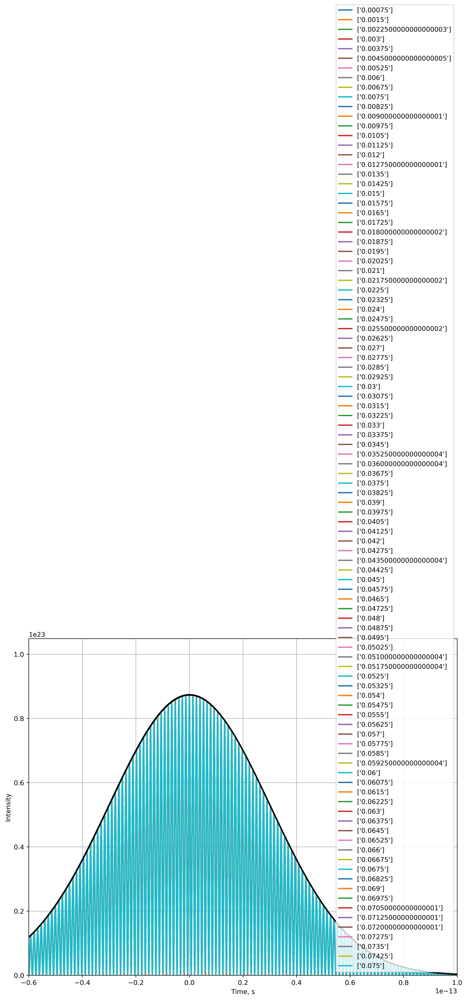

In [10]:
multiple_runs.plot.combined_intensity_time(xlim=(-60e-15, 100e-15),
                                           representation="mode",
                                           field="both")

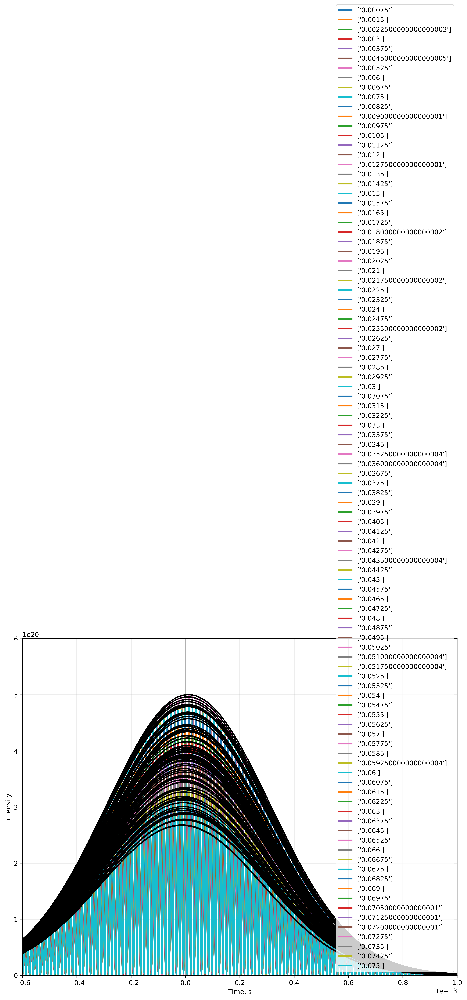

In [11]:
multiple_runs.plot.combined_intensity_time(xlim=(-60e-15, 100e-15),
                                           representation="radial",
                                           field="both")

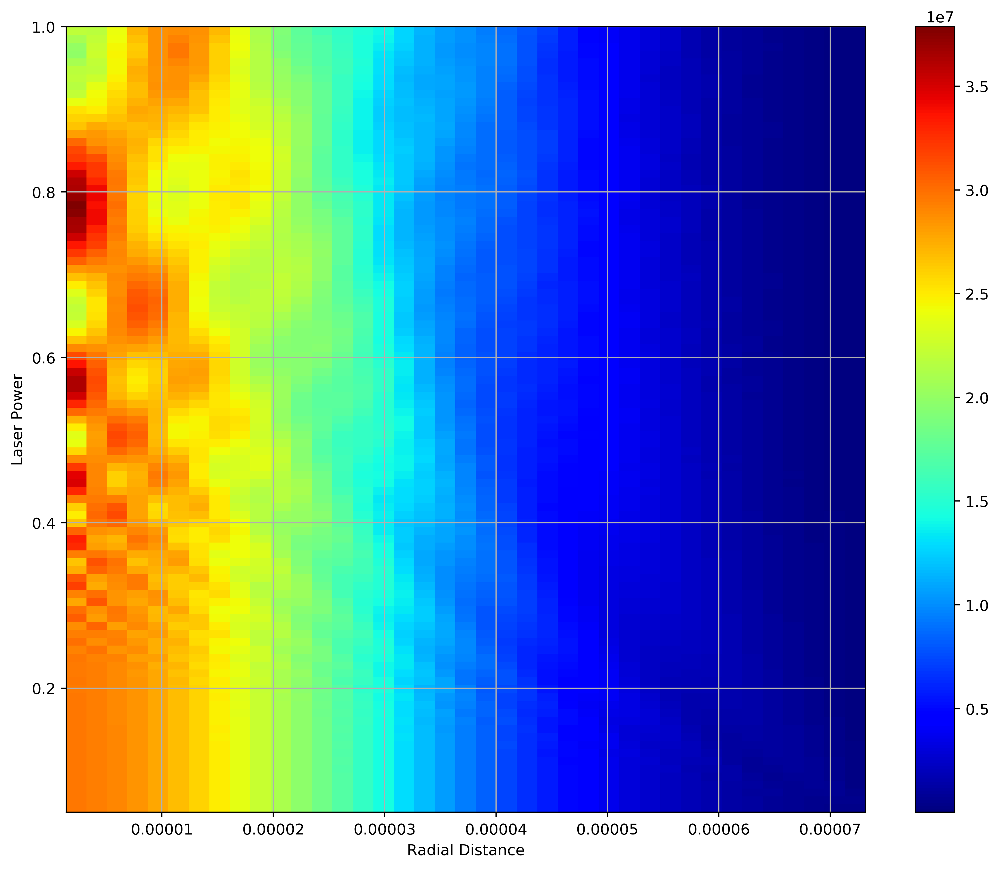

In [12]:
multiple_runs.plot.combined_intensity_radialDistance_power()

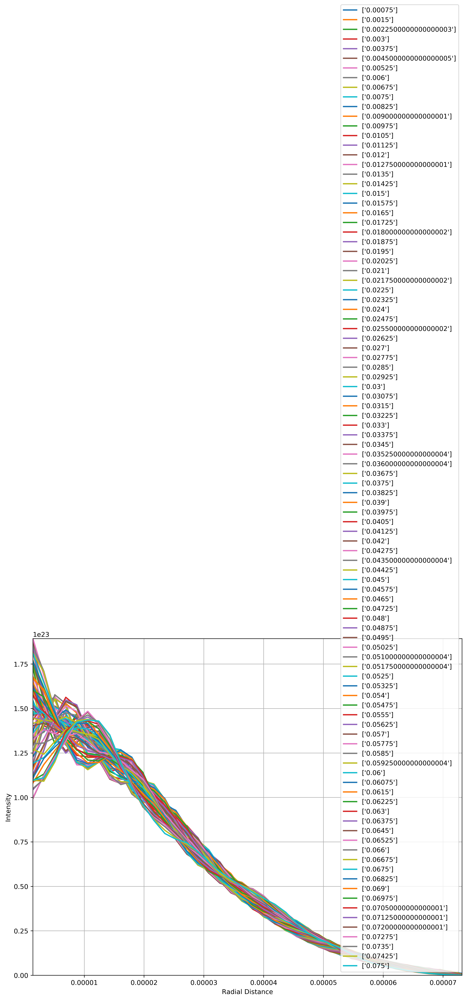

In [13]:
multiple_runs.plot.combined_intensity_radialDistance()

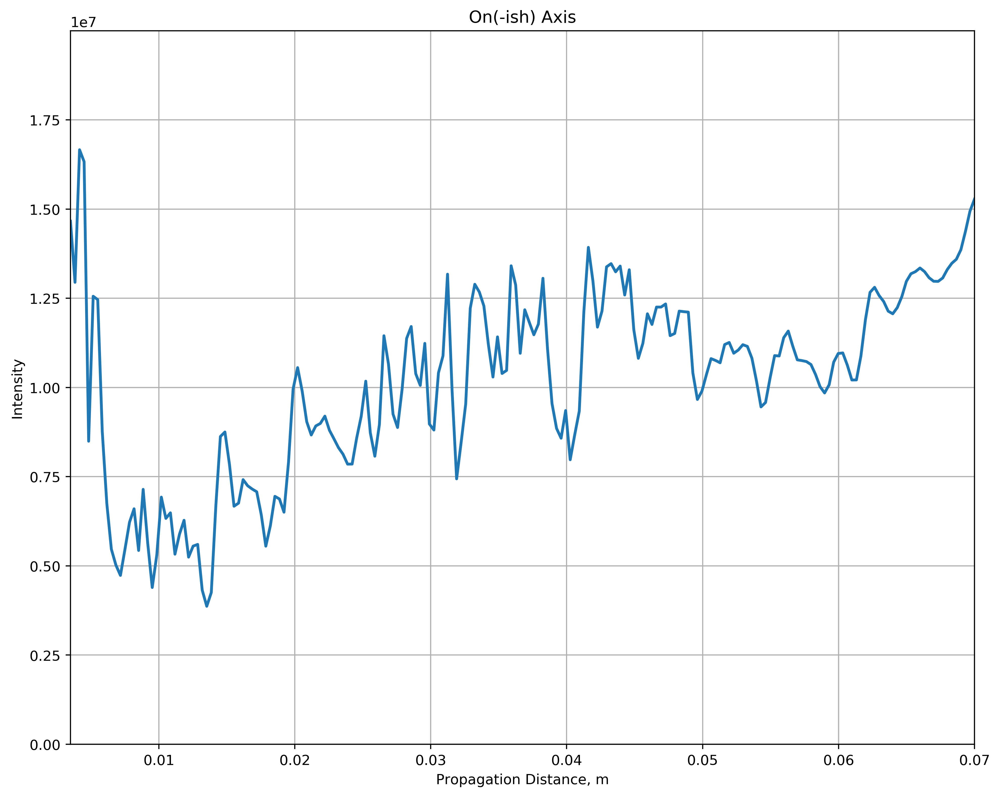

In [11]:
multiple_runs.plot.combined_propagationDistance_Intensity(x_range=x_range,
                                                          #xlim=(0.0035, 0.07),
                                                          #ylim=(0.0E22, 3.0E22),
                                                          representation="radial",
                                                          position="on-axis")

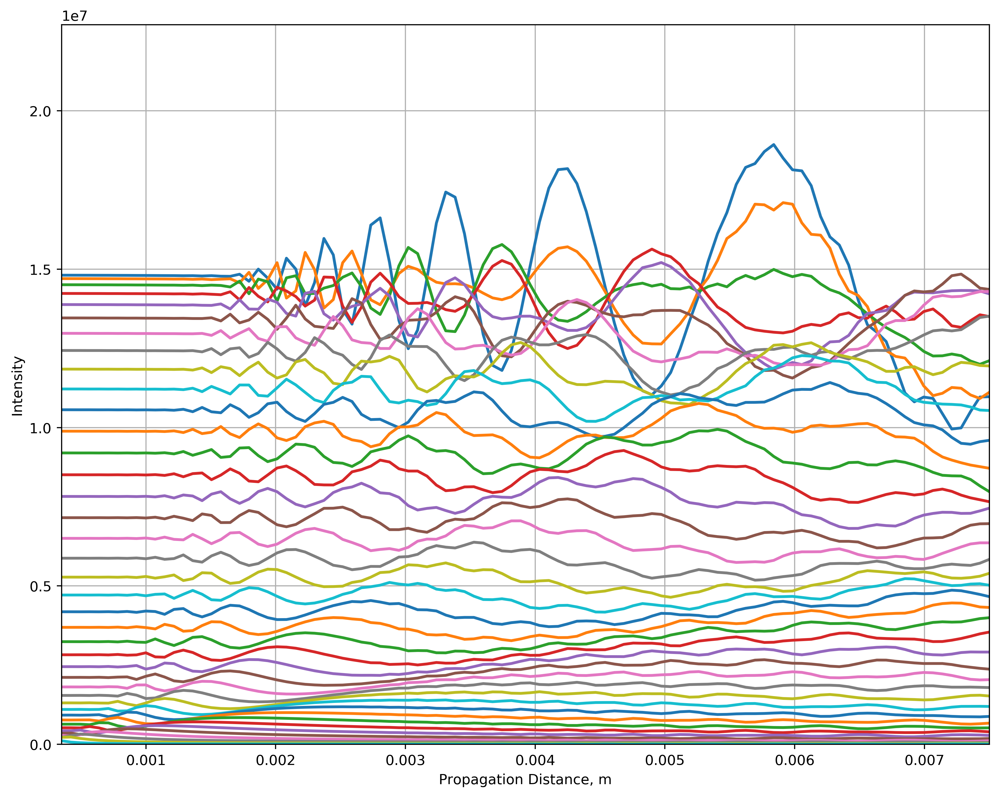

In [4]:
multiple_runs.plot.combined_propagationDistance_Intensity(x_range=x_range,
                                                          #xlim=(0.0035, 0.07),
                                                          #ylim=(0.0E22, 3.0E22),
                                                          representation="radial",
                                                          position="all")

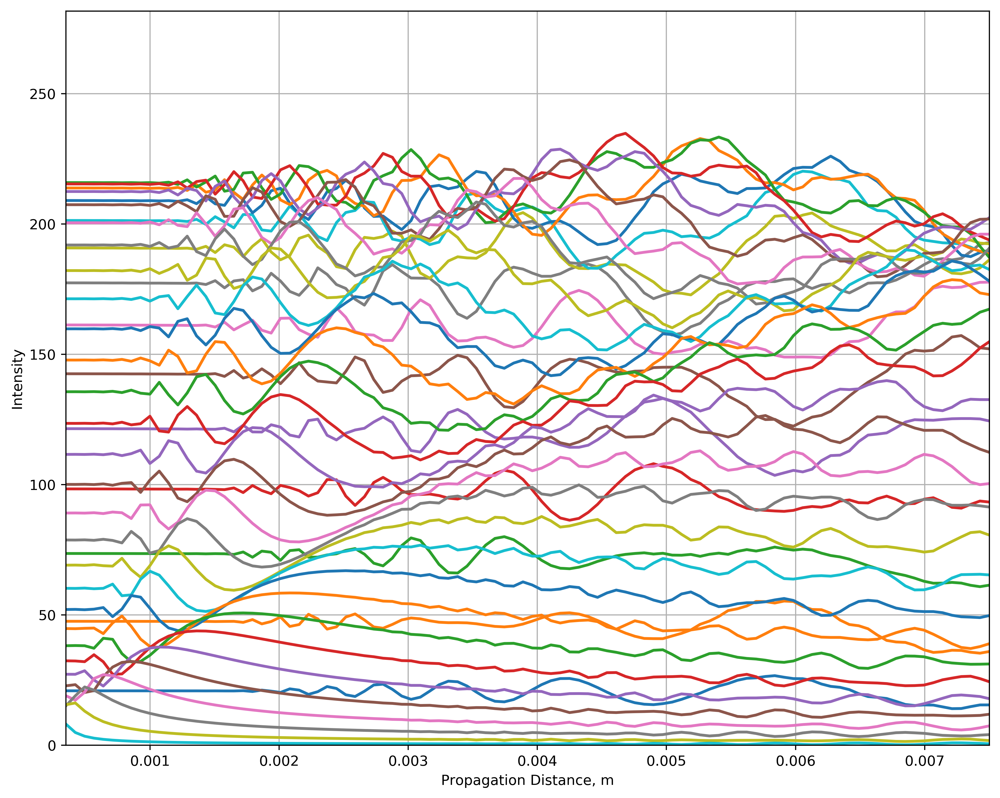

In [16]:
multiple_runs.plot.combined_propagationDistance_Intensity(x_range=x_range,
                                                          #xlim=(0.0035, 0.07),
                                                          #ylim=(0.0E20, 4.0E17),
                                                          representation="radial",
                                                          position="all",
                                                          radially_weighted=True)

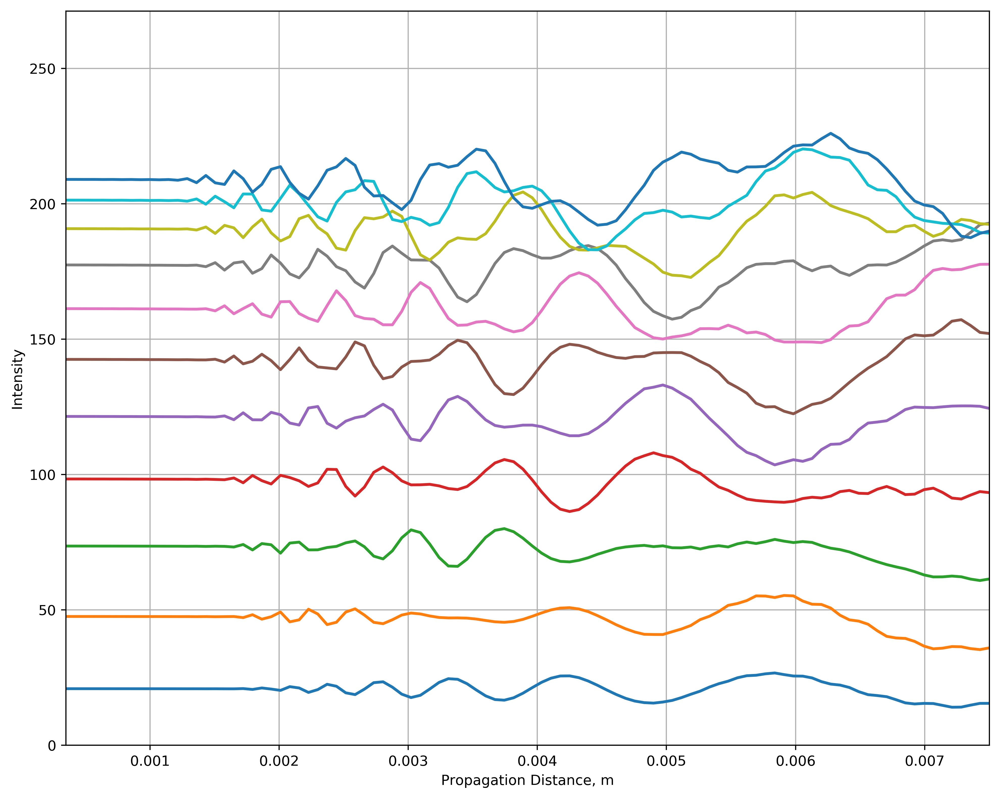

In [4]:
multiple_runs.plot.combined_propagationDistance_Intensity(x_range=x_range,
                                                          #xlim=(0.0035, 0.07),
                                                          #ylim=(0.0E20, 4.0E17),
                                                          representation="radial",
                                                          position="all",
                                                          radially_weighted=True,
                                                          positions=11)

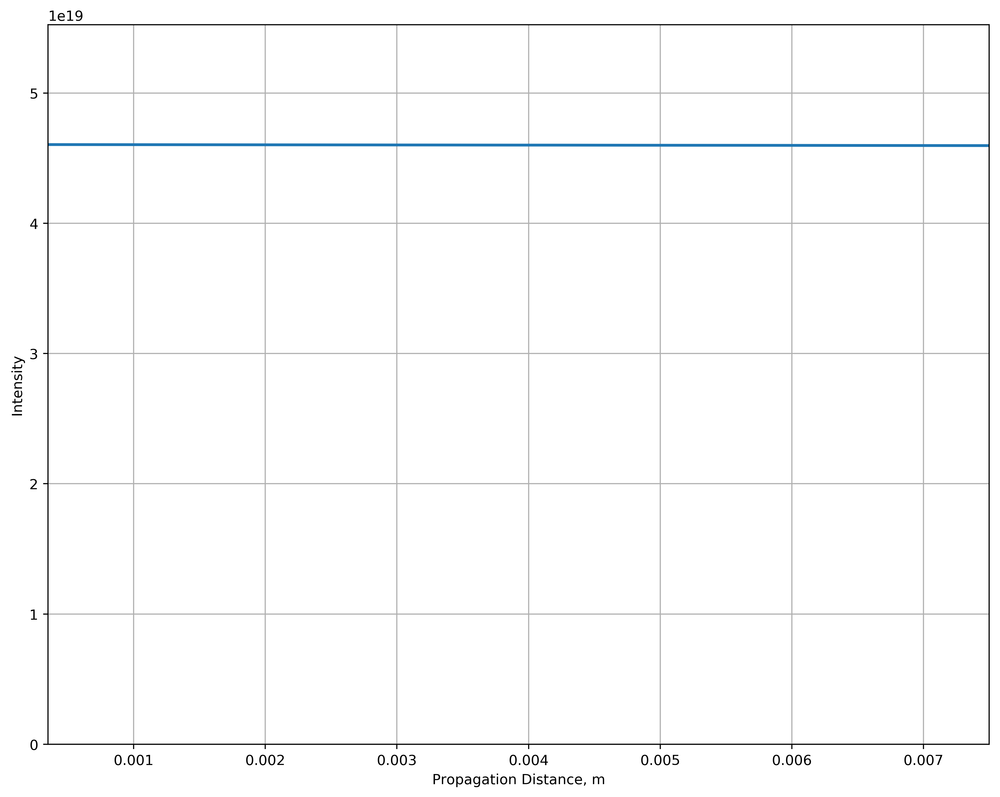

In [4]:
multiple_runs.plot.combined_propagationDistance_Intensity(x_range=x_range,
                                                          #xlim=(0.0035, 0.07),
                                                          #ylim=(6.6E18, 7.1E18),
                                                          representation="radial",
                                                          position="all",
                                                          radially_integrated=True)

In [9]:
print(np.max(np.sum(multiple_runs.plot._combined_I_t_r, axis=2)[:,0]))
print(np.min(np.sum(multiple_runs.plot._combined_I_t_r, axis=2)[:,0]))

print((np.max(np.sum(multiple_runs.plot._combined_I_t_r, axis=2)[:,0]) - np.min(np.sum(multiple_runs.plot._combined_I_t_r, axis=2)[:,0]))/np.max(np.sum(multiple_runs.plot._combined_I_t_r, axis=2)[:,0]))

(2.70096602787e+22+0j)
(1.39271513001e+22+0j)
(0.48436406988+0j)


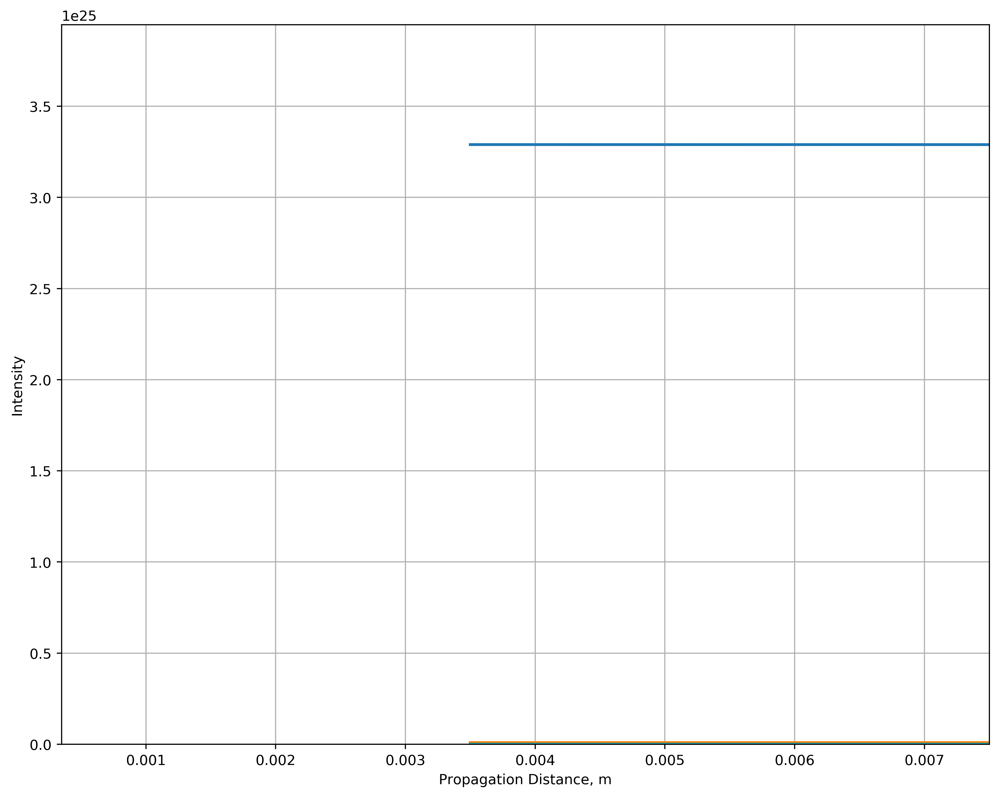

In [5]:
multiple_runs.plot.combined_propagationDistance_Intensity(xlim=x_range,
                                                          representation="mode")

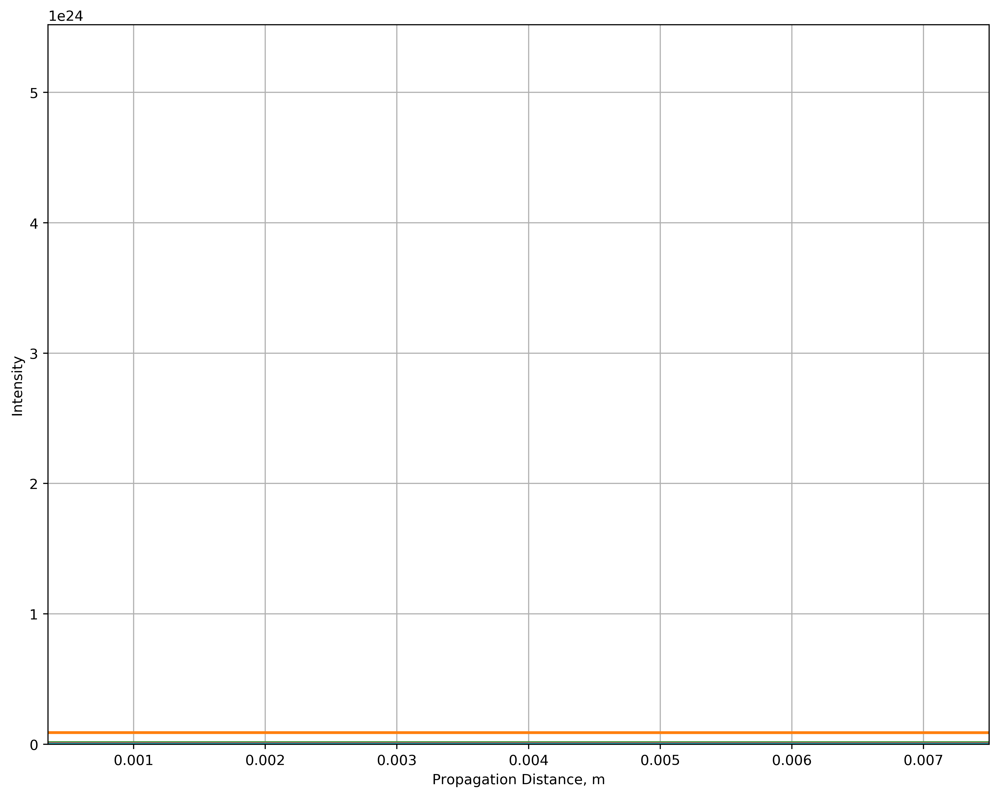

In [6]:
multiple_runs.plot.combined_propagationDistance_Intensity(x_range=x_range,
                                                          #xlim=(0.0035, 0.07),
                                                          ylim=(0.0E24, 5.52E24),
                                                          representation="mode")

In [10]:
print(np.max(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,0]))
print(np.min(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,0]))

print(np.min(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,0])/np.max(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,0]))

(5.01736944523e+24+0j)
(4.78331266114e+24+0j)
(0.953350697681+0j)


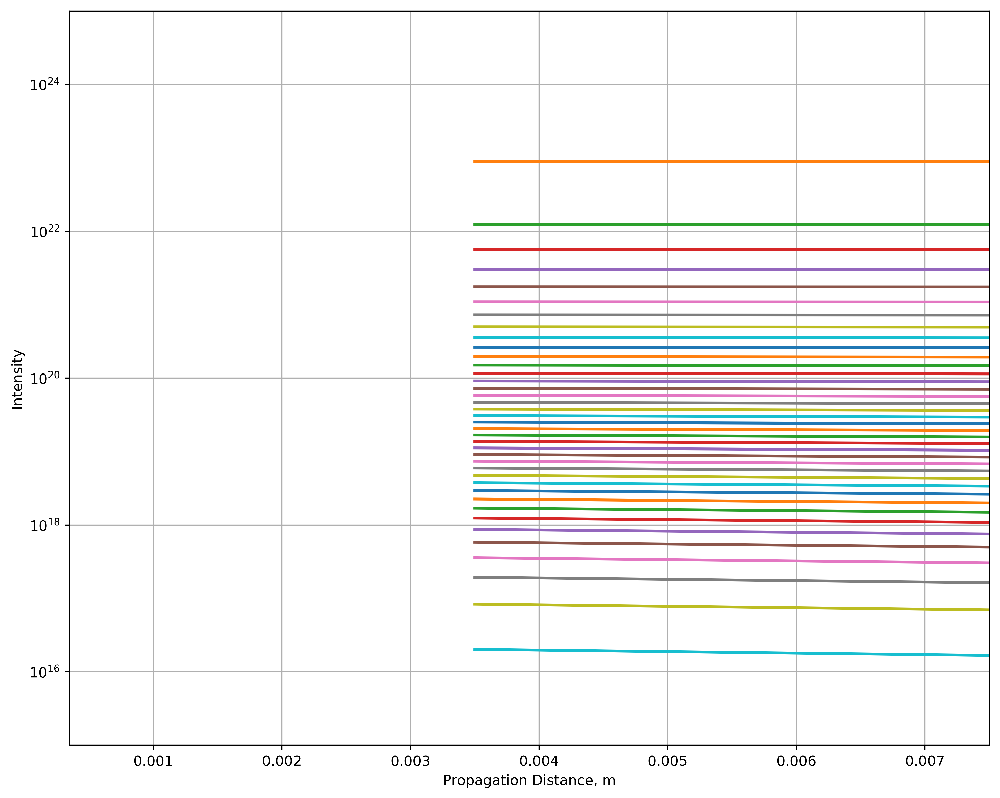

In [7]:
multiple_runs.plot.combined_propagationDistance_Intensity(xlim=x_range,
                                                          ylim=(1.0E15, 1.0E25),
                                                          representation="mode",
                                                          semilogy=True)

In [21]:
print(np.max(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,0]))
print(np.max(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,1]))

print(np.max(np.sum(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,1:], axis=1))/np.max(np.sum(multiple_runs.plot._combined_I_t_m, axis=2)[:,0]))

AttributeError: 'Plot' object has no attribute '_combined_I_t_m'

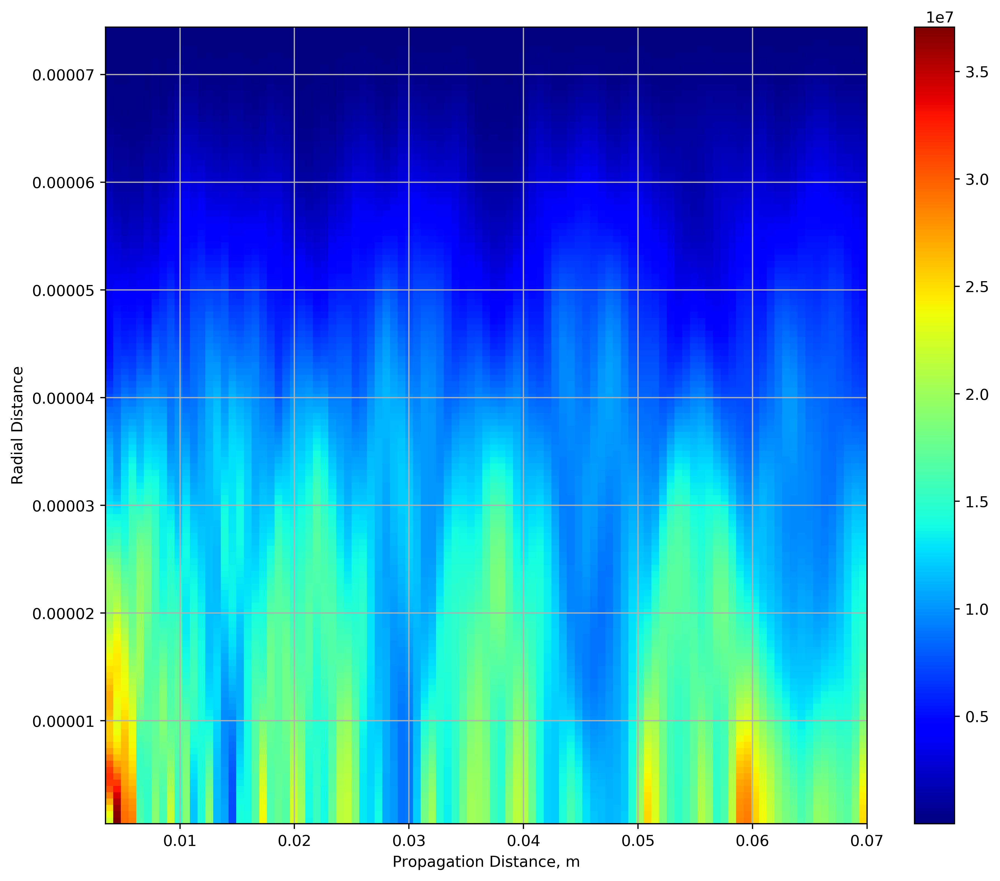

In [7]:
multiple_runs.plot.combined_propagationDistance_radialDistance(x_range=x_range)

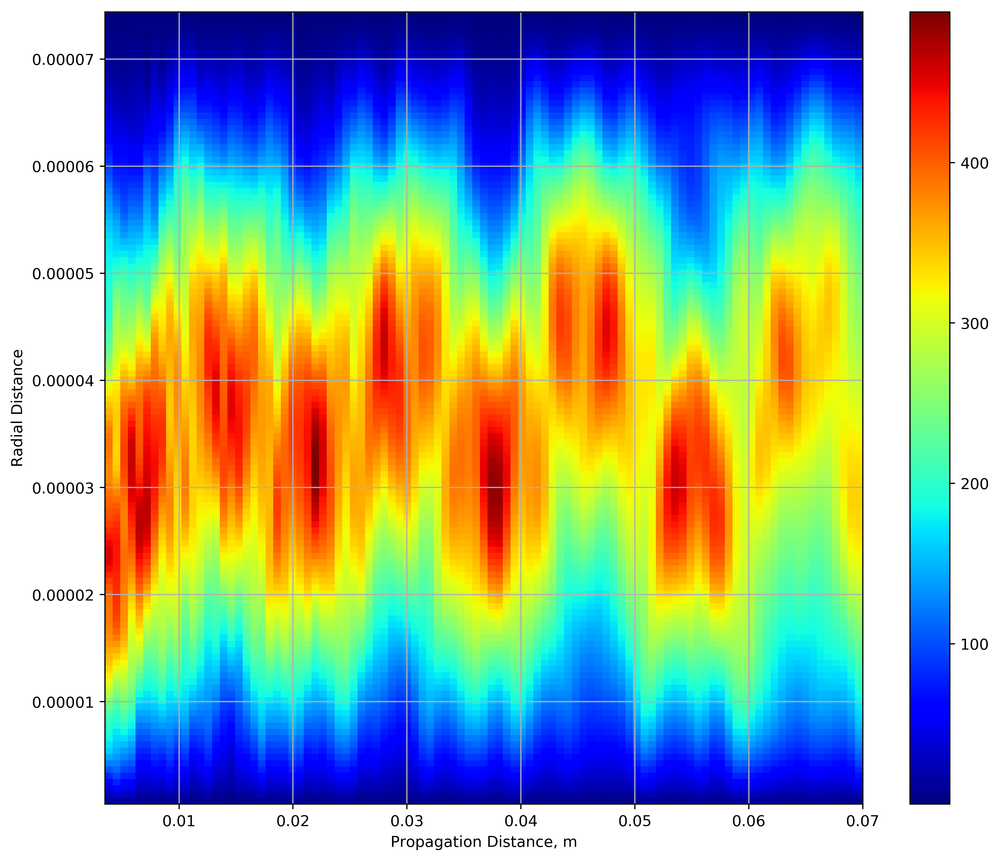

In [4]:
multiple_runs.plot.combined_propagationDi stance_radialDistance(x_range=x_range, radially_weighted=True)

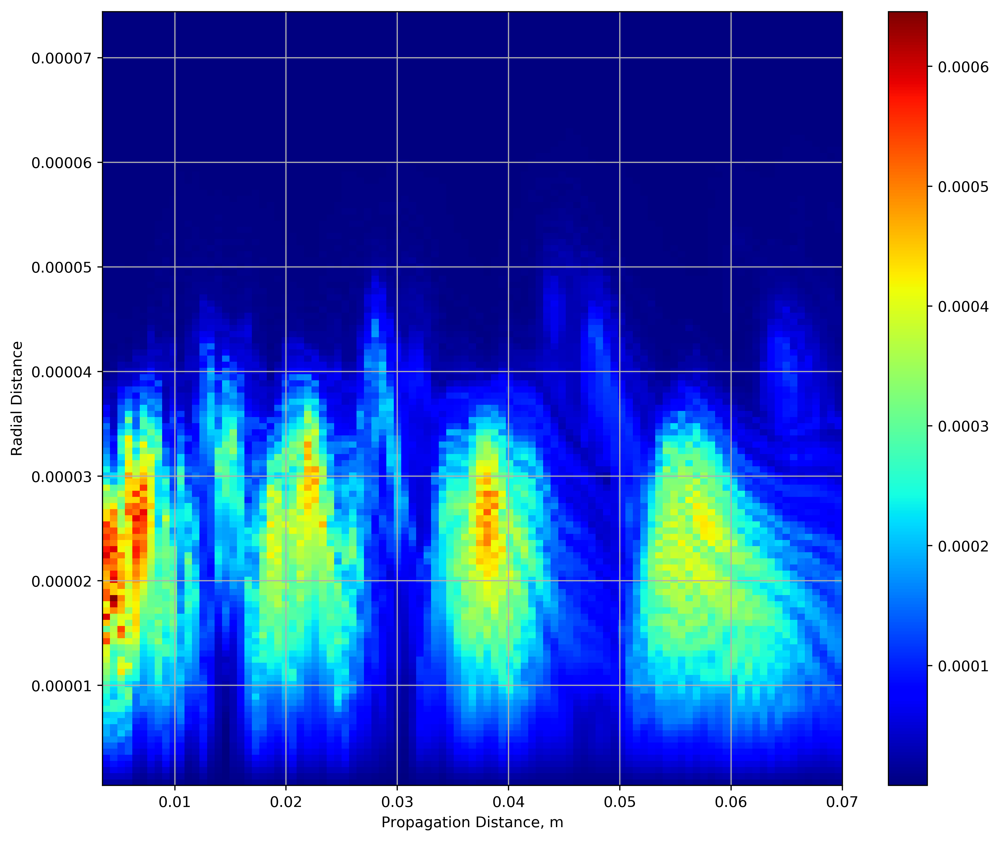

In [3]:
multiple_runs.plot.combined_propagationDistance_radialDistance(representation='spectral',
                                                               field='carrier',
                                                               x_range=x_range,
                                                               radially_weighted=True)

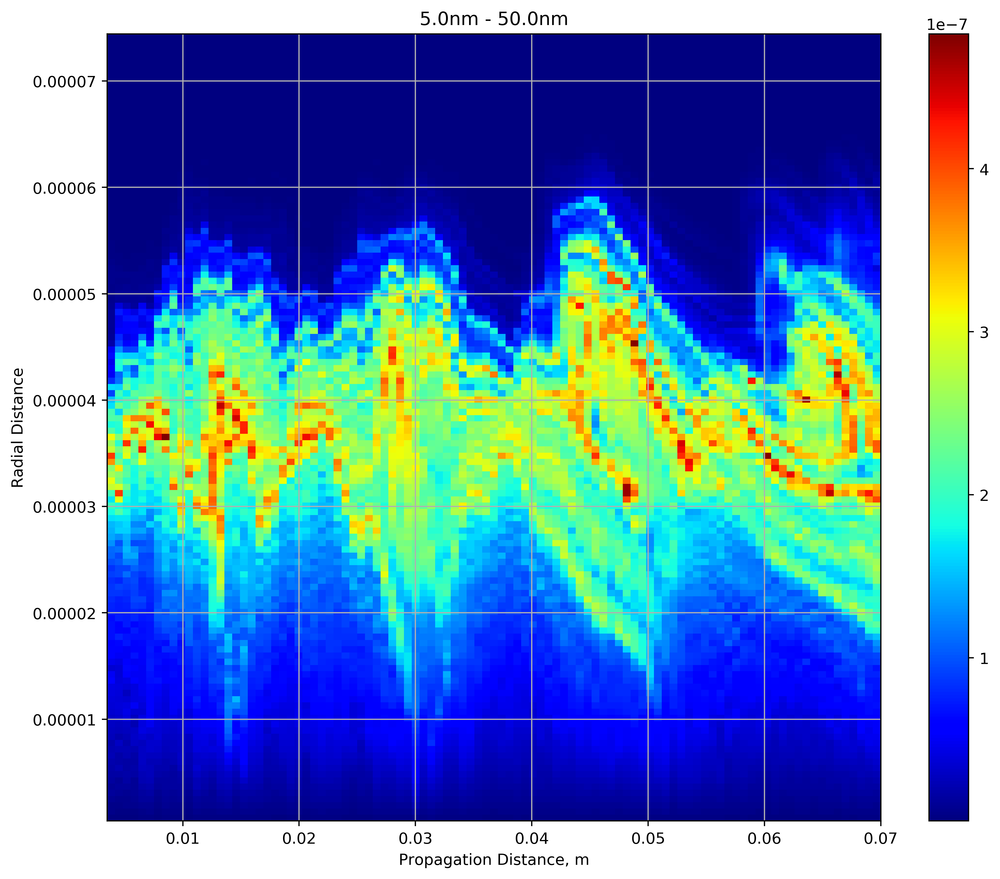

In [14]:
multiple_runs.plot.combined_propagationDistance_radialDistance(representation='spectral',
                                                               field='carrier',
                                                               x_range=x_range,
                                                               window=(5e-9, 50e-9),
                                                               radially_weighted=True)

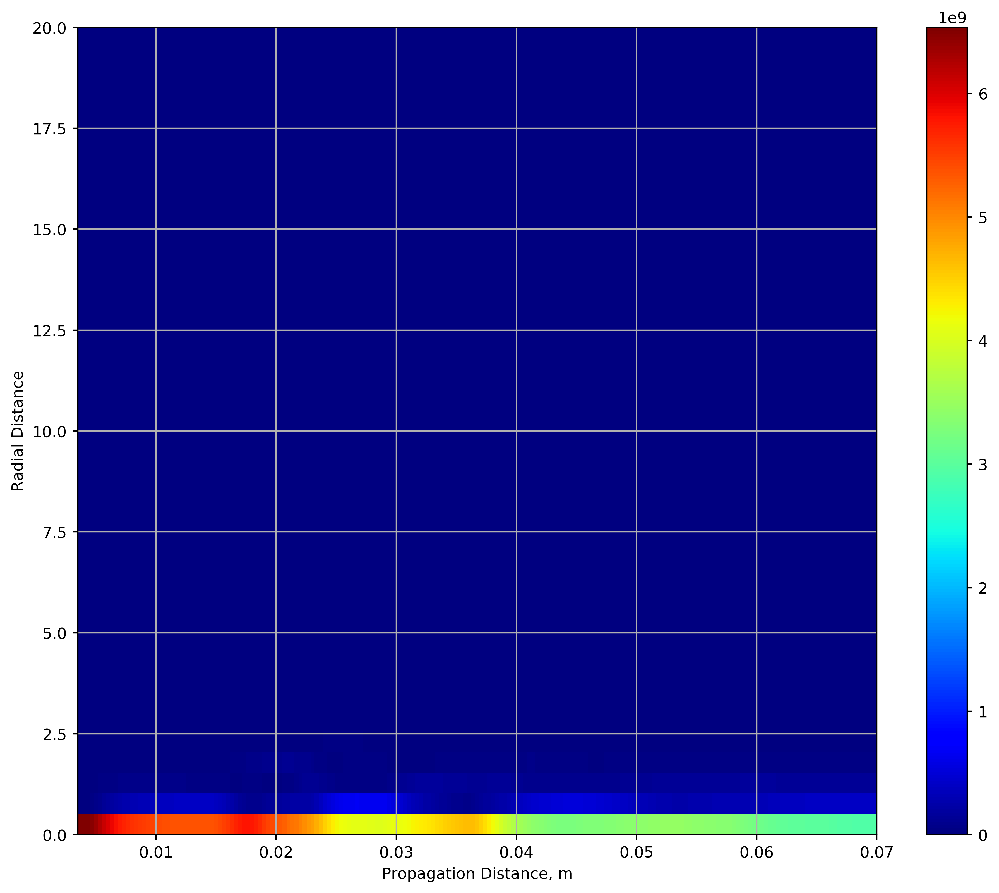

In [14]:
multiple_runs.plot.combined_propagationDistance_mode(x_range=x_range)